# ProgFest 2024 - Introduction à l'apprentissage machine
Crédits: Catherine Bouchard

<table><tr>
<td> <img src="https://iid.ulaval.ca/wp-content/themes/iid/images/logo-iid-Institut-intelligence-donnees.svg"> </td>
<td> <img src="http://www.cttei.com/wp-content/uploads/logo-ulaval-reseaux-sociaux-300x158.jpg"> </td>
<td> <img src="https://neuro.ulaval.ca/sites/default/files/CERVO_Centre_Logo.png"> </td>
</tr></table>

<img src="https://miro.medium.com/max/1400/1*8gmgaAkFdI-9OHY5cA93xQ.png" width="800" align="center"/>

## C'est quoi, la vision numérique?

"La vision par ordinateur est un domaine de l'intelligence artificielle (IA) qui permet aux ordinateurs et aux systèmes de dériver des informations significatives à partir d'images numériques, de vidéos et d'autres entrées visuelles, et de prendre des mesures ou de faire des recommandations sur la base de ces informations. Si l'intelligence artificielle permet aux ordinateurs de penser, la vision par ordinateur leur permet de voir, d'observer et de comprendre." - IBM, *Qu'est-ce que la Computer Vision?*

<table><tr>
<td> <img src="https://d2ph5fj80uercy.cloudfront.net/05/cat722.jpg"> </td>
<td> <img src="https://d2ph5fj80uercy.cloudfront.net/04/cat3995.jpg"> </td>
<td> <img src="https://d2ph5fj80uercy.cloudfront.net/05/cat2655.jpg"> </td>
</tr></table>

Source : thesecatsdonotexist.com



## Initialisation
Si vous exécutez ce Notebook via Google Colab, assurez-vous de télécharger les fichiers nécessaires en exécutant la cellule suivante.

In [13]:
os.chdir("/content")

if not os.path.isfile("BootcampIID2024_ComputerVision.zip"):
    !wget https://s3.valeria.science/flclab-public-data/data/BootcampIID2024_ComputerVision.zip
    !unzip /BootcampIID2024_ComputerVision.zip


In [14]:
# Lib used
import warnings; warnings.simplefilter('ignore')

import io
import os
import time
import copy
import urllib
import requests

%matplotlib notebook
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches
matplotlib.rcParams.update({'font.size': 22})

import skimage
import skimage.io
import skimage.filters
import skimage.transform
import skimage.morphology
import skimage.segmentation

from PIL import Image
import cv2
import imageio

import numpy as np
import json

import scipy
import scipy.ndimage
from scipy.ndimage.interpolation import rotate
from scipy.stats.kde import gaussian_kde

from IPython import display

import torch
import torch.nn as nn
import torchvision
import torchvision.models as models
from torch.optim import Adam

from torchvision import transforms
from torch.autograd import Variable

axisoff = lambda ax: [x.axis('off') for x in ax.ravel()]

# C'est quoi, une image?
Du point de vue d'un ordinateur, une image est une matrice 2-dimensions (image en tons de gris) ou 3-dimensions (images couleur).

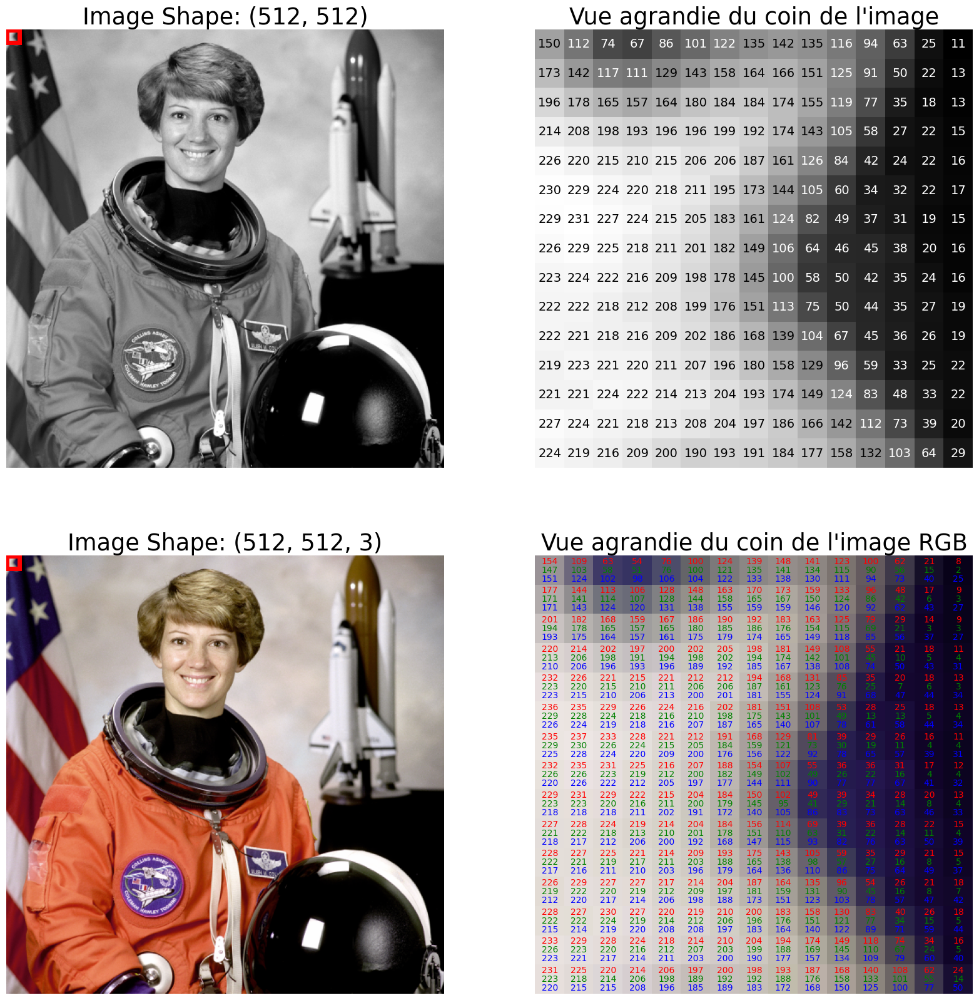

In [15]:
%matplotlib inline
matplotlib.rcParams.update({'font.size': 22})

###---Parameters---###
crop_size = 15
###----------------###

image_color = skimage.data.astronaut()
image_gray = np.mean(image_color, axis=2).astype(np.uint8) # RGB to Grayscale
output_shape = (image_gray.shape[0]//20, image_gray.shape[1]//20)
image_crop = image_gray[:crop_size,:crop_size]

fig, axs = plt.subplots(2, 2, figsize=(20,20))

axs[0,1].imshow(image_crop, cmap='gist_gray')
axs[1,1].imshow(image_color[:crop_size,:crop_size])
axs[0,1].set_title('Vue agrandie du coin de l\'image')
axs[1,1].set_title('Vue agrandie du coin de l\'image RGB')
for x in range(image_crop.shape[1]):
    for y in range(image_crop.shape[0]):
        rgb_pixel_intensity = image_color[y, x]
        grayscale_pixel_intensity = image_crop[y, x]
        adaptative_gray_color = 'black' if grayscale_pixel_intensity > 255/2 else 'white'

        axs[0,1].text(x, y, s=grayscale_pixel_intensity,
            horizontalalignment='center',
            verticalalignment='center',
            fontsize=14,
            color=adaptative_gray_color) # Gray channel
        axs[1,1].text(x, y-0.3, s=rgb_pixel_intensity[0],
            horizontalalignment='center',
            verticalalignment='center',
            fontsize=10,
            color='red') # Red channel
        axs[1,1].text(x, y, s=rgb_pixel_intensity[1],
            horizontalalignment='center',
            verticalalignment='center',
            fontsize=10,
            color='green') # Green channel
        axs[1,1].text(x, y+0.3, s=rgb_pixel_intensity[2],
            horizontalalignment='center',
            verticalalignment='center',
            fontsize=10,
            color='blue') # Blue channel

axs[0,0].imshow(image_gray, cmap='gist_gray')
axs[0,0].set_title(f"Image Shape: {image_gray.shape}")

# Add rectangle patches of the cropped regions
rectG = matplotlib.patches.Rectangle(
    (0, 0), width=crop_size, height=crop_size,
    linewidth=5, edgecolor='red', facecolor='none')
rectRGB = matplotlib.patches.Rectangle(
    (0, 0), width=crop_size, height=crop_size,
    linewidth=5, edgecolor='red', facecolor='none')
axs[0,0].add_patch(rectG)
axs[1,0].add_patch(rectRGB)

axs[1,0].imshow(image_color)
axs[1,0].set_title(f"Image Shape: {image_color.shape}")
axisoff(axs)
print()

[(0.0, 1.0, 0.0, 1.0),
 (-0.5, 14.5, 14.5, -0.5),
 (0.0, 1.0, 0.0, 1.0),
 (-0.5, 14.5, 14.5, -0.5),
 (-0.5, 14.5, 14.5, -0.5),
 (-0.5, 14.5, 14.5, -0.5)]

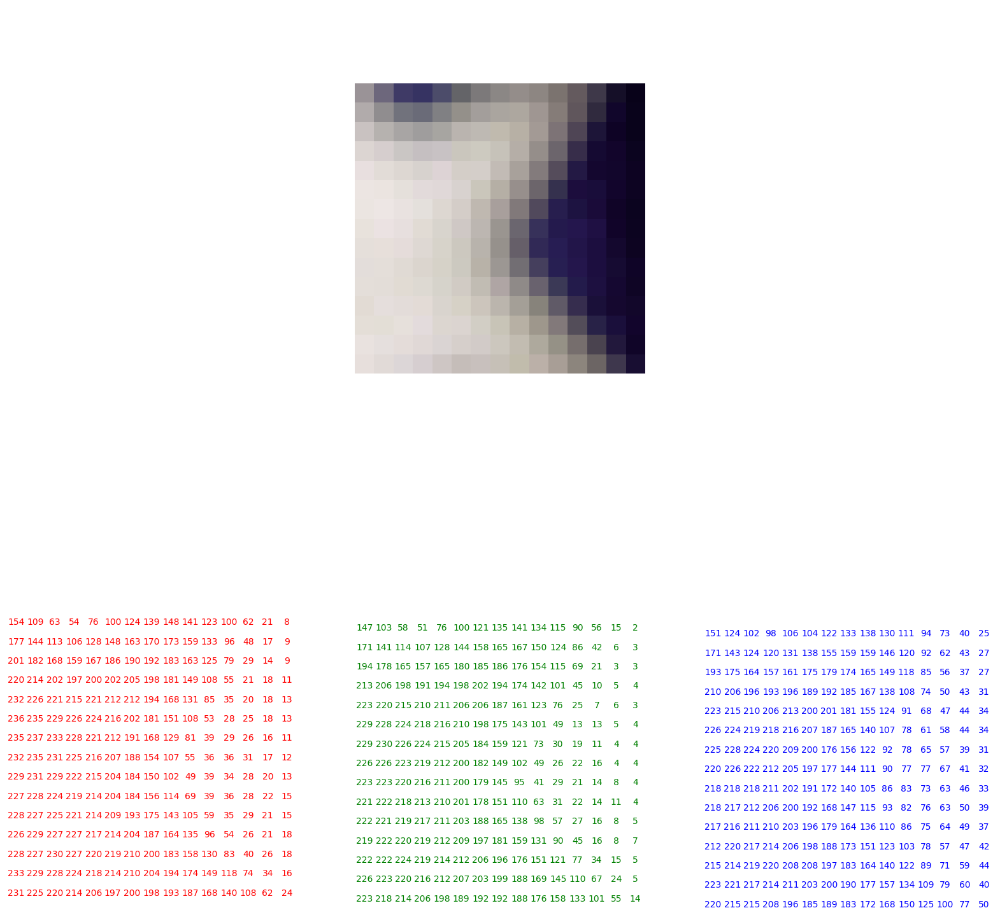

In [16]:
fig, axs = plt.subplots(2, 3, figsize=(20,20))
axs[1,0].imshow(image_crop*0, cmap='binary')
axs[1,1].imshow(image_crop*0, cmap='binary')
axs[1,2].imshow(image_crop*0, cmap='binary')

for x in range(image_crop.shape[1]):
    for y in range(image_crop.shape[0]):
        rgb_pixel_intensity = image_color[y, x]
        grayscale_pixel_intensity = image_crop[y, x]
        adaptative_gray_color = 'black'

        axs[1,0].text(x, y-0.3, s=rgb_pixel_intensity[0],
            horizontalalignment='center',
            verticalalignment='center',
            fontsize=10,
            color='red') # Red channel
        axs[1,1].text(x, y, s=rgb_pixel_intensity[1],
            horizontalalignment='center',
            verticalalignment='center',
            fontsize=10,
            color='green') # Green channel
        axs[1,2].text(x, y+0.3, s=rgb_pixel_intensity[2],
            horizontalalignment='center',
            verticalalignment='center',
            fontsize=10,
            color='blue') # Blue channel

axs[0,1].imshow(image_color[:crop_size,:crop_size])
axisoff(axs)

# L'analyse d'images

Si on vous demande de trouver Charlie dans l'image suivante, comment procèdez-vous?

(-0.5, 1023.5, 767.5, -0.5)

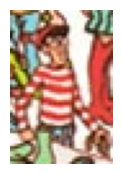

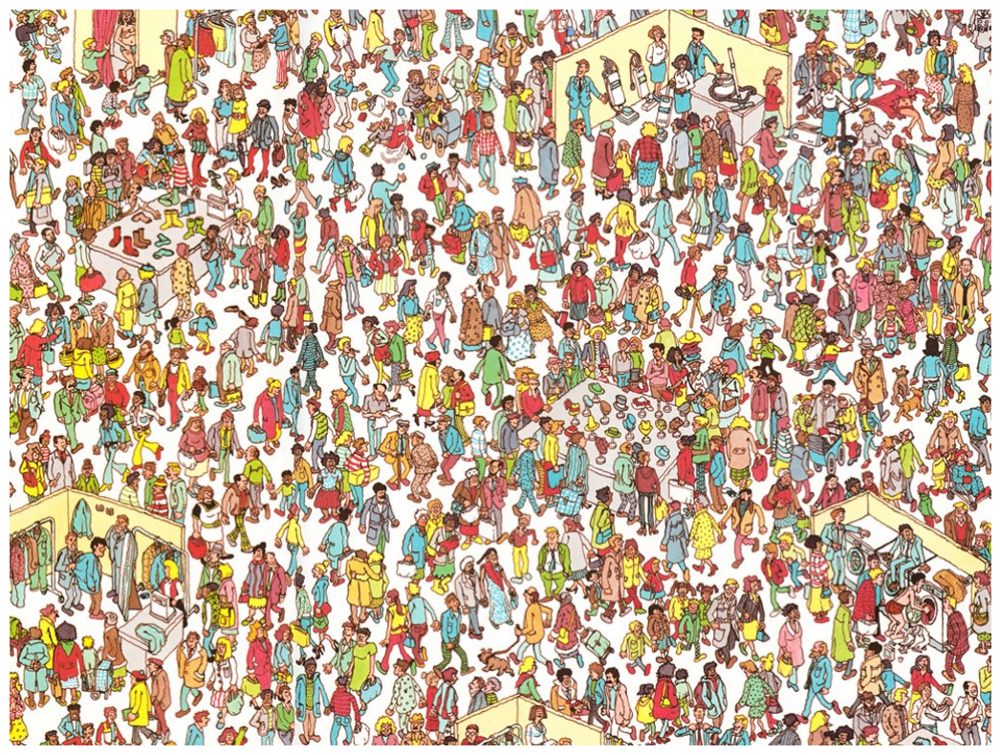

In [17]:
complete_image = imageio.imread('whereiswaldo/complete_image.jpg')
thing_to_find = complete_image[140:200,160:200,:]

matplotlib.rcParams.update({'font.size': 18})

fig, ax = plt.subplots(figsize=(2,2))
ax.imshow(thing_to_find)
ax.axis('off')

fig2, ax2 = plt.subplots(figsize=(20,10))
ax2.imshow(complete_image)
ax2.axis('off')

Vous gardez probalement une image mentale de Charlie, et balayez l'image jusqu'à ce que votre regard s'arrête sur une section qui correspond à cette image mentale.

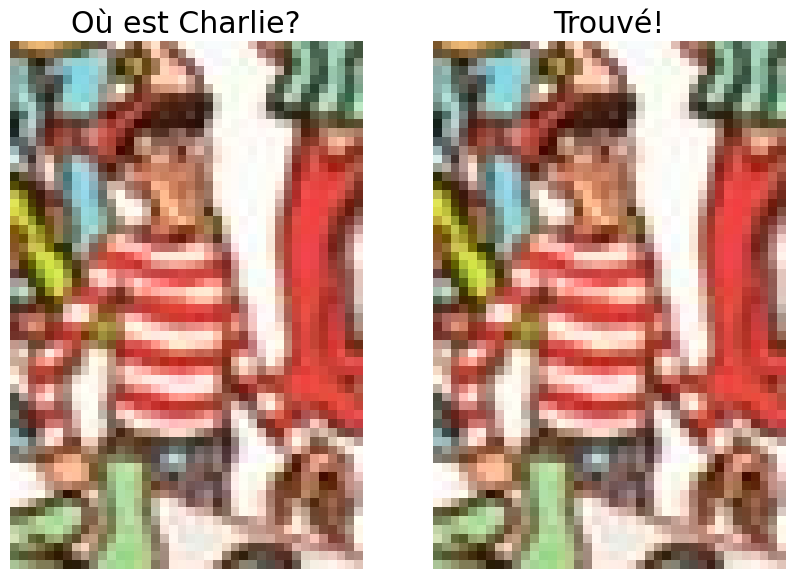

In [18]:
matplotlib.rcParams.update({'font.size': 18})

###--Parameters--###
stride = 20
###--------------###

fig, axs = plt.subplots(1,2,figsize=(10,10))
axs[0].imshow(thing_to_find)
axs[0].set_title('Où est Charlie?')
for ax in axs.ravel():
	ax.axis('off')

raise_flag = False
for i in range(120,complete_image.shape[0]-stride,stride):
    for j in range(0,complete_image.shape[1]-stride,stride):
        axs[1].imshow(complete_image[i:i+60,j:j+40,:])
        display.display(plt.gcf())
        display.clear_output(wait=True)
        time.sleep(0.05)
        if j == 160 and i == 140:
            axs[1].set_title('Trouvé!')
            raise_flag = True
            break
    if raise_flag:
        break


Pour qu'un algorithme trouve Charlie, on peut faire l'équivalant: balayer l'image de Charlie de gauche à droite et de haut en bas, sur l'image complète. À chaque itération, on peut calculer le niveau de similarité entre l'image de Charlie, et la section de l'image qui est balayée.

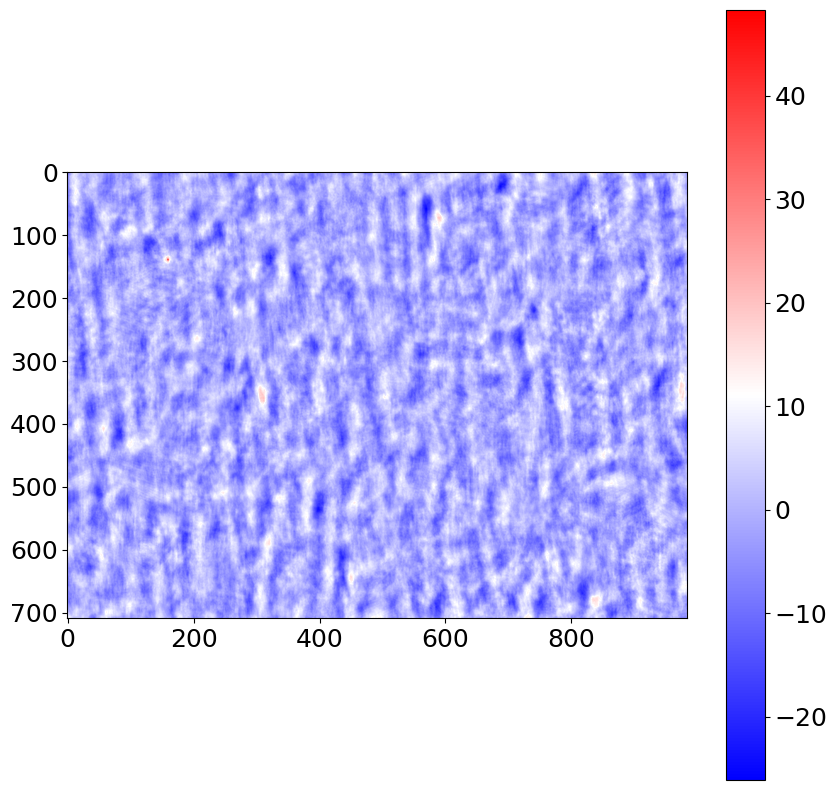

In [19]:
# Binarize images between -1 and 1 to compute correspondance
image_bin = complete_image[:,:,0]
waldo_bin = image_bin[140:200,160:200]

def convolution2d(image, kernel, stride, padding):
    if len(image.shape)>2:
        image = np.pad(image, [(padding, padding), (padding, padding), (0,0)], mode='constant', constant_values=0)
    else:
        image = np.pad(image, [(padding, padding), (padding, padding)], mode='constant', constant_values=0)

    kernel_height, kernel_width = kernel.shape[:2]
    padded_height, padded_width = image.shape[:2]

    output_height = (padded_height - kernel_height) // stride + 1
    output_width = (padded_width - kernel_width) // stride + 1

    new_image = np.zeros((output_height, output_width)).astype(np.float32)

    if len(image.shape)>2:
        for y in range(0, output_height):
            for x in range(0, output_width):
                new_image[y][x] = np.mean(image[y * stride:y * stride + kernel_height, x * stride:x * stride + kernel_width, :] * kernel).astype(np.float32)
    else:
        for y in range(0, output_height):
            for x in range(0, output_width):
                new_image[y][x] = np.mean(image[y * stride:y * stride + kernel_height, x * stride:x * stride + kernel_width] * kernel).astype(np.float32)

    return new_image

waldo_bin = (waldo_bin>np.median(waldo_bin)) * 2 - 1 # Convert [0,1] to [-1,1]

output = convolution2d(image_bin, waldo_bin, 1, 0)
fig, axs = plt.subplots(figsize=(10,10))
plt.imshow(output,cmap='bwr')
plt.colorbar()

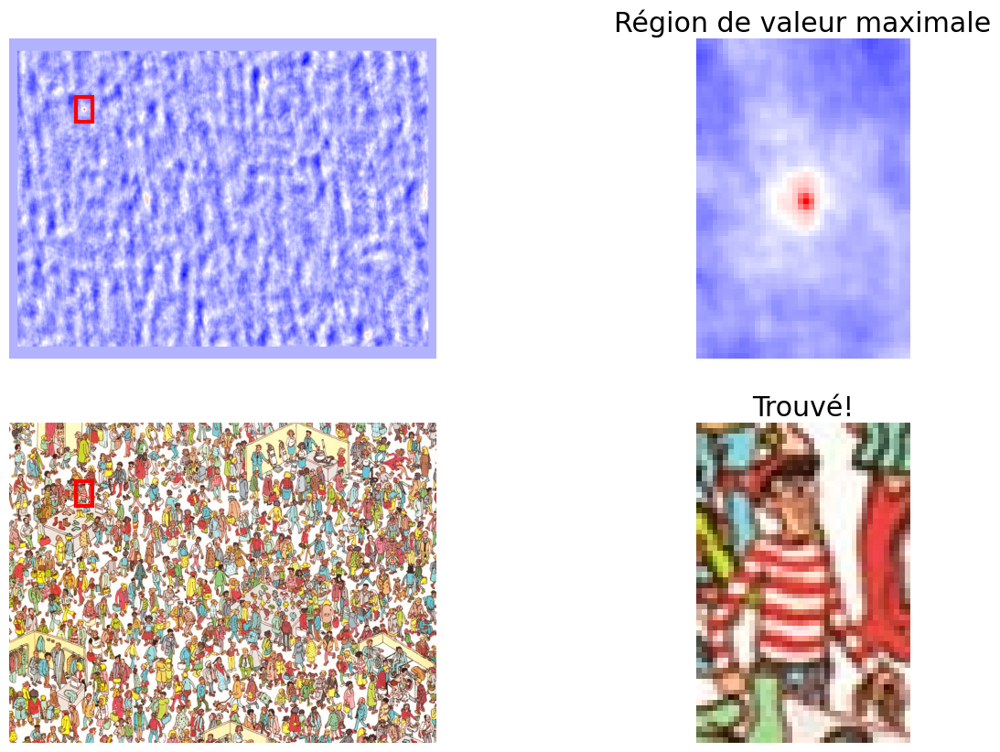

In [20]:
fig, axs = plt.subplots(2,2,figsize=(15,10))

# Pad the output so that it has the same size as the original image
output_pad = np.pad(output,((30,29),(20,19)))

# Create a Rectangle patch
rect = patches.Rectangle((160,140), 40, 60, linewidth=3, edgecolor='r', facecolor='none')
rect2 = patches.Rectangle((160,140), 40, 60, linewidth=3, edgecolor='r', facecolor='none')

# Add the patch to the Axes
axs[0,0].add_patch(rect)
axs[0,0].imshow(output_pad,cmap='bwr')

axs[0,1].imshow(output_pad[140:200,160:200], cmap='bwr',vmin=output.min(), vmax=output.max())
axs[0,1].set_title('Région de valeur maximale')

axs[1,0].add_patch(rect2)
axs[1,0].imshow(complete_image)
axs[1,1].imshow(complete_image[140:200,160:200])
axs[1,1].set_title('Trouvé!')

for ax in axs.ravel():
    ax.axis('off')


Le filtre qu'on a défini pour Charlie n'est pas général; la même procédure ne permet pas d'identifier Charlie dans une image différente, parce qu'il est trop spécifique à une seule image.

In [21]:
### Can't find Waldo in a different scene
%matplotlib notebook
complete_image2 = imageio.imread('whereiswaldo/complete_image2.jpg')
complete_image2_bin = complete_image2[:,:,0]
fig, axs = plt.subplots(2,1,figsize=(12,15),sharex=True,sharey=True)
axs[0].imshow(complete_image2)

output2 = convolution2d(complete_image2_bin, waldo_bin, 1, 0)
output2 = np.pad(output2,((30,29),(20,19)))
im = axs[1].imshow(output2,cmap='bwr',vmin=output.min(), vmax=output.max())

axs[0].set_title('Nouvelle scène')
axs[1].set_title('Résultat')

for ax in axs:
    ax.axis('off')

<IPython.core.display.Javascript object>

In [22]:
### Define filter with red stripes
%matplotlib inline
#------#
filter_size = (12,12)
axis = 1 # 0 : vertical, 1 : horizontal
#------#

# Définition d'un filtre de Sobel de taille (filter_size)
def custom_sobel(shape, axis):
    """
    shape must be odd: eg. (5,5)
    axis is the direction, with 0 to positive x and 1 to positive y
    """
    k = np.zeros(shape)
    p = [(j,i) for j in range(shape[0])
           for i in range(shape[1])
           if not (i == (shape[1] -1)/2. and j == (shape[0] -1)/2.)]

    for j, i in p:
        j_ = int(j - (shape[0] -1)/2.)
        i_ = int(i - (shape[1] -1)/2.)
        k[j,i] = (i_ if axis==0 else j_)/float(i_*i_ + j_*j_)
    return k

def custom_stripes(shape,axis,width):

    k = np.ones(shape)
    for i in range(0,k.shape[axis],2*width):
        if axis == 0:
            k[:,i:i+width] = 0
        if axis == 1:
            k[i:i+width,:] = 0
    return k

# Uncomment one of the following filters:
#red_stripe = custom_sobel(filter_size,axis) # Horizontal or vertical red stripe
red_stripe = custom_stripes(filter_size, axis, width=3) # Red/white/red stripes
#red_stripe = rotate(custom_stripes(filter_size, axis, width=3), angle=45, reshape=False, order=0)

# Convert to 0-255 range for visualization
red_stripe = (red_stripe - red_stripe.min())/(red_stripe.max() - red_stripe.min())

# Convert to rgb
red_stripe = np.stack((red_stripe,)*3, axis=-1)
red_stripe[:,:,0] = np.ones(filter_size)
red_stripe[:,:,1] = 1-red_stripe[:,:,1]    # zero the green channel
red_stripe[:,:,2] = 1-red_stripe[:,:,2]    # zero the blue channel

plt.imshow(red_stripe)

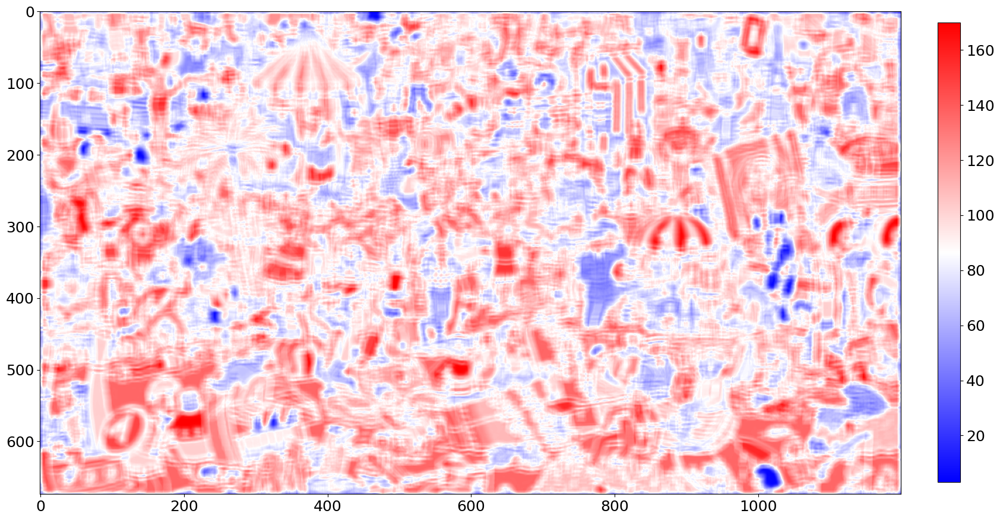

In [24]:
# Is a red stripe filter sufficient to find Waldo?
output_redstripe = convolution2d(complete_image2, red_stripe, 1, int((filter_size[0]-1)/2))

fig, ax = plt.subplots(figsize=(20,20))
im = ax.imshow(output_redstripe,cmap='bwr')
plt.colorbar(im,fraction=0.025, pad=0.04)

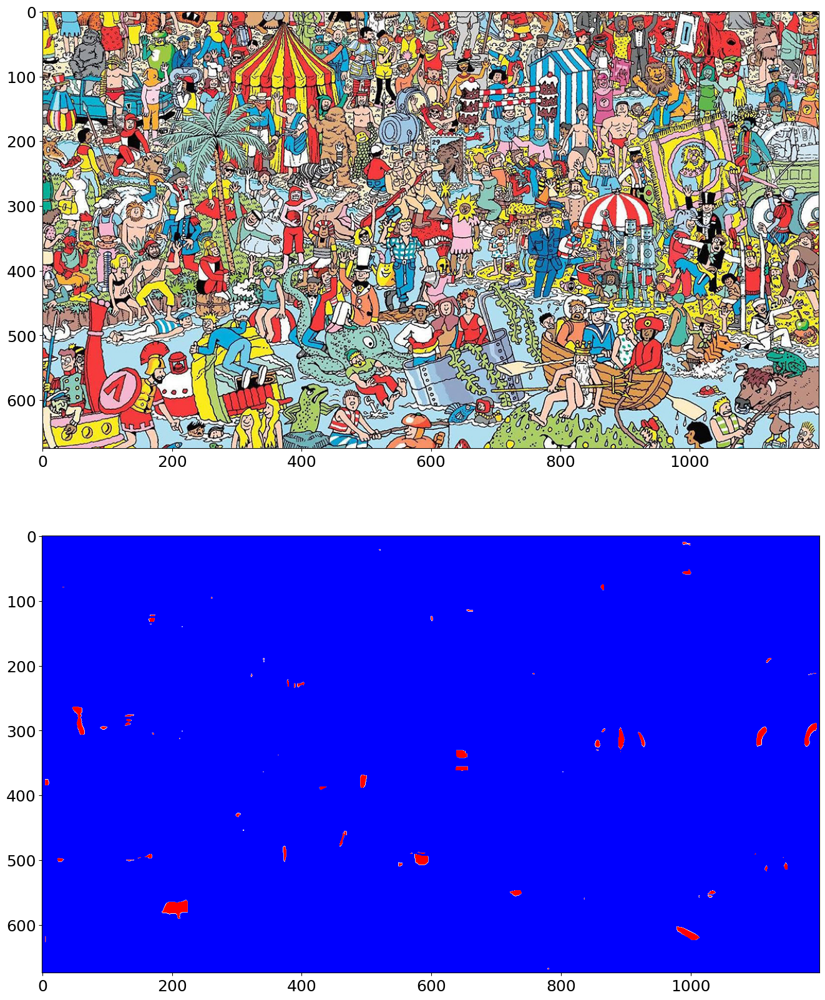

In [25]:
#------#
threshold = 150
#------#

fig, axs = plt.subplots(2,1,figsize=(20,20))
axs[0].imshow(complete_image2)
axs[1].imshow(output_redstripe>threshold,cmap='bwr')

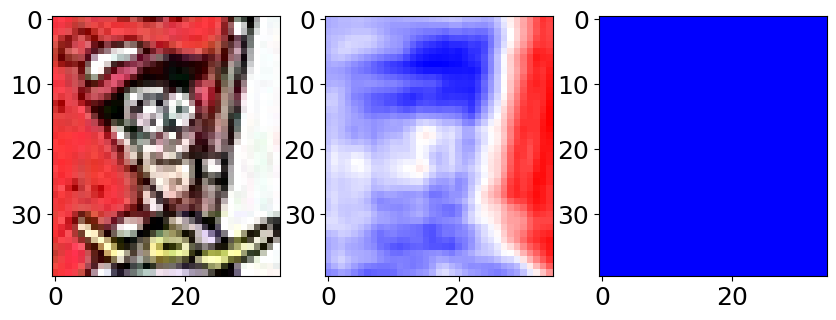

In [26]:
# Zoom in on Waldo
fig, axs = plt.subplots(1,3,figsize=(10,10))

axs[0].imshow(complete_image2[20:60,950:985], cmap='bwr')
axs[1].imshow(output_redstripe[20:60,950:985], cmap='bwr')
axs[2].imshow(output_redstripe[20:60,950:985]>threshold, cmap='bwr')

## La convolution
La convolution est l'opération mathématique des réseaux de neurones convolutifs (CNN), le type de réseau le plus utilisé en apprentissage profond appliqué aux images. Une convolution est définie par un filtre qui est appliqué séquentiellement à des sous-sections de l'image de la même taille que le filtre. Le filtre est glissé sur l'ensemble de l'image et à chaque pas, le résultat de la convolution est la somme de la multiplication élément par élément du filtre et de la section de l'image.  

La section suivante montre, étape par étape, comment appliquer un filtre de convolution à une image. Vous pouvez modifier les paramètres pour voir l'effet sur le résultat !

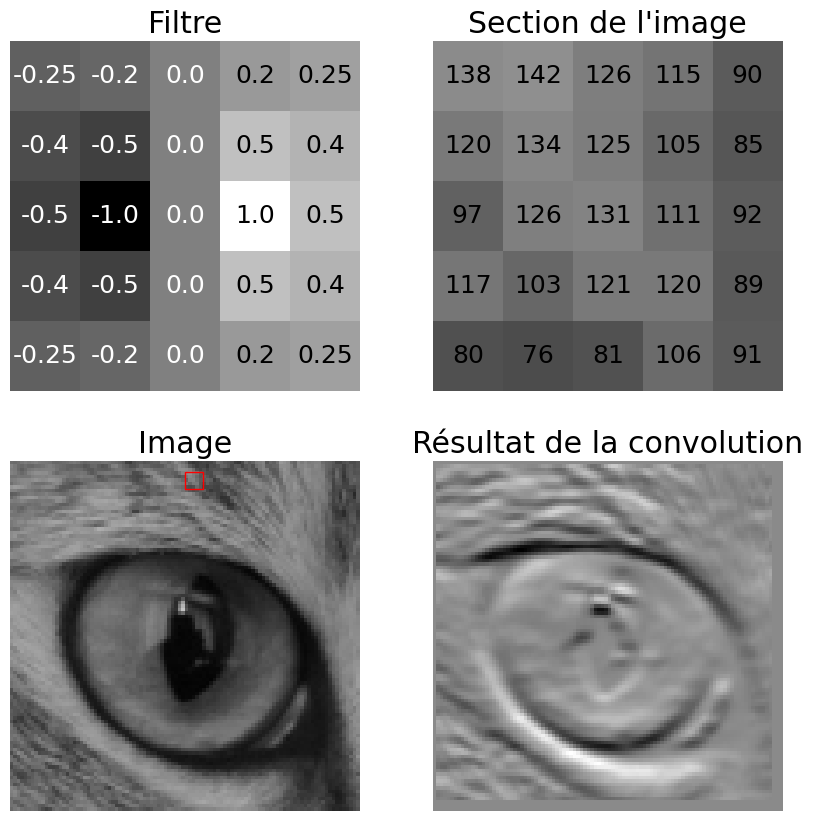

In [27]:
matplotlib.rcParams.update({'font.size': 18})

im_color = skimage.data.cat()
im = np.mean(im_color[60:160,120:220],axis=2)

###--Parameters--###
kernel_size = 5 # must be odd here
stride = 1
padding = 1
###--------------###

filter = custom_sobel((kernel_size,kernel_size),0)

feature_map_dim0 = int((im.shape[0]+2*padding-(kernel_size-1)-1)/stride + 1)
feature_map_dim1 = int((im.shape[1]+2*padding-(kernel_size-1)-1)/stride + 1)

# Result that builds iteratively
conv_result = np.zeros((feature_map_dim0+2*padding,feature_map_dim1+2*padding))

fig, ax = plt.subplots(2,2,figsize=(10,10))
ax[0,0].imshow(filter,cmap='gist_gray')
for xx in range(filter.shape[0]):
  for yy in range(filter.shape[1]):
    if filter[xx,yy]>0:
      color = 'k'
    else:
      color = 'w'
    ax[0,0].text(yy,xx,s=filter[xx,yy],color=color,horizontalalignment='center',verticalalignment='center')
ax[0,0].set_title('Filtre')
ax[1,1].set_title('Résultat de la convolution')

for axi in ax.ravel():
	axi.axis('off')

time_limit = 30
time_before = time.time()
for i in range(feature_map_dim0-int(2*padding/stride)):
  for j in range(feature_map_dim1-int(2*padding/stride)):
    conv_result[i+padding,j+padding] = np.sum(np.matmul(filter, im[stride*i:stride*i+kernel_size, stride*j:stride*j+kernel_size]))
    # update display only every N steps, otherwise it is too slow
    if time.time()-time_before<time_limit:
      if j % 10 == 0:
        ax[1,0].cla()
        ax[1,0].imshow(im, cmap='gist_gray', vmin=0, vmax=255)
        ax[1,0].axis('off')
        conv = matplotlib.patches.Rectangle((-0.5+stride*j,-0.5+stride*i), width=kernel_size, height=kernel_size, linewidth=1, edgecolor='r', facecolor='none')
        ax[1,0].add_patch(conv)
        ax[1,0].set_title('Image')

        im_section = im[stride*i:stride*i+kernel_size, stride*j:stride*j+kernel_size]
        ax[0,1].cla()
        ax[0,1].imshow(im_section, cmap='gist_gray',vmin=0,vmax=255)
        ax[0,1].set_title('Section de l\'image')
        ax[0,1].axis('off')
        for xx in range(filter.shape[0]):
          for yy in range(filter.shape[1]):
            ax[0,1].text(yy,xx,s=im_section[xx,yy].astype(int),color=color,horizontalalignment='center',verticalalignment='center')

        ax[1,1].imshow(conv_result, cmap='gist_gray')
        display.display(plt.gcf())
        display.clear_output(wait=True)
        time.sleep(0.1)

ax[1,1].imshow(conv_result, cmap='gist_gray')




### Pourquoi utiliser la convolution ?

Les filtres de convolution sont utilisés pour mettre en évidence les caractéristiques d'une image qui s'étendent sur plusieurs pixels. Le résultat d'une convolution appliquée à une image s'appelle une carte de caractéristiques. Les cartes de caractéristiques indiquent les endroits de l'image qui contiennent l'élément d'intérêt défini par le filtre : un cercle, une ligne droite verticale, un point, etc. En appliquant plusieurs filtres les uns après les autres, les éléments mis en évidence peuvent devenir plus complexes : un œil, une oreille de chat, une roue de voiture, etc.

La section de code suivante montre le résultat d'un filtre simple, le filtre Sobel, qui permet de mettre en évidence les bords horizontaux, verticaux et diagonaux d'une image.

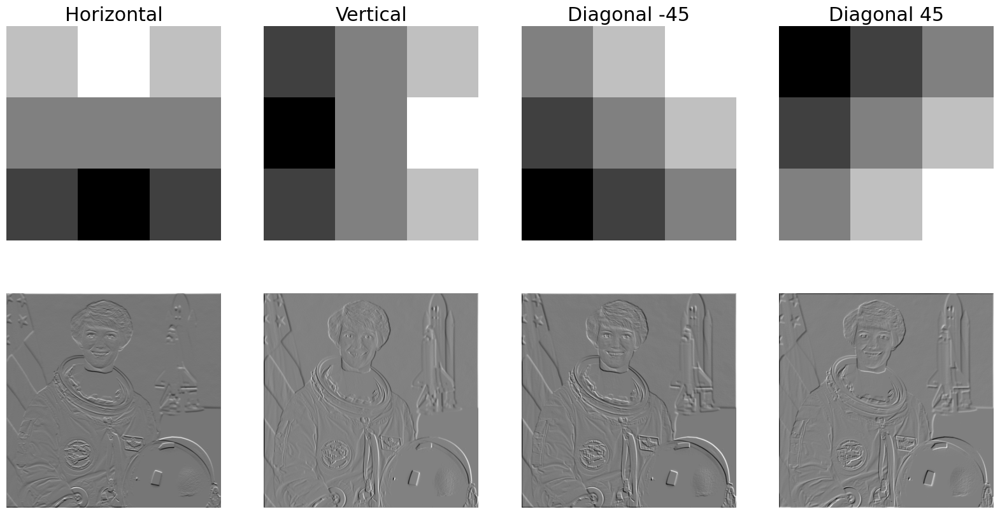

In [29]:
fig, axs = plt.subplots(2,4,figsize=(20,10))
im = np.mean(skimage.data.astronaut(),axis=2)

sobel_horizontal = np.array([[1,2,1], [0,0,0], [-1,-2,-1]])
sobel_vertical = np.array([[-1,0,1], [-2,0,2], [-1,0,1]])
sobel_diagonal1 = np.array([[0,1,2], [-1,0,1], [-2,-1,0]])
sobel_diagonal2 = np.array([[-2,-1,0], [-1,0,1], [0,1,2]])

filter_list = [sobel_horizontal, sobel_vertical, sobel_diagonal1, sobel_diagonal2]
filter_name_list = ['Horizontal', 'Vertical', 'Diagonal -45', 'Diagonal 45']

for idx, filter in enumerate(filter_list):
  axs[0,idx].imshow(filter, cmap='gist_gray')
  axs[1,idx].imshow(scipy.signal.convolve2d(im,filter), cmap='gist_gray')
  axs[0,idx].set_title(filter_name_list[idx])
  axs[0,idx].axis('off')
  axs[1,idx].axis('off')

plt.show()

# Apprentissage profond appliqué aux images

## Réseau de neurones pleinement connecté

<img src="https://miro.medium.com/v2/resize:fit:720/format:webp/1*VHOUViL8dHGfvxCsswPv-Q.png" width="500" align="center"/>

Taille initiale: (15, 15, 3)
Taille modifiée: (675,)
Taille modifiée: (1, 675)


[]

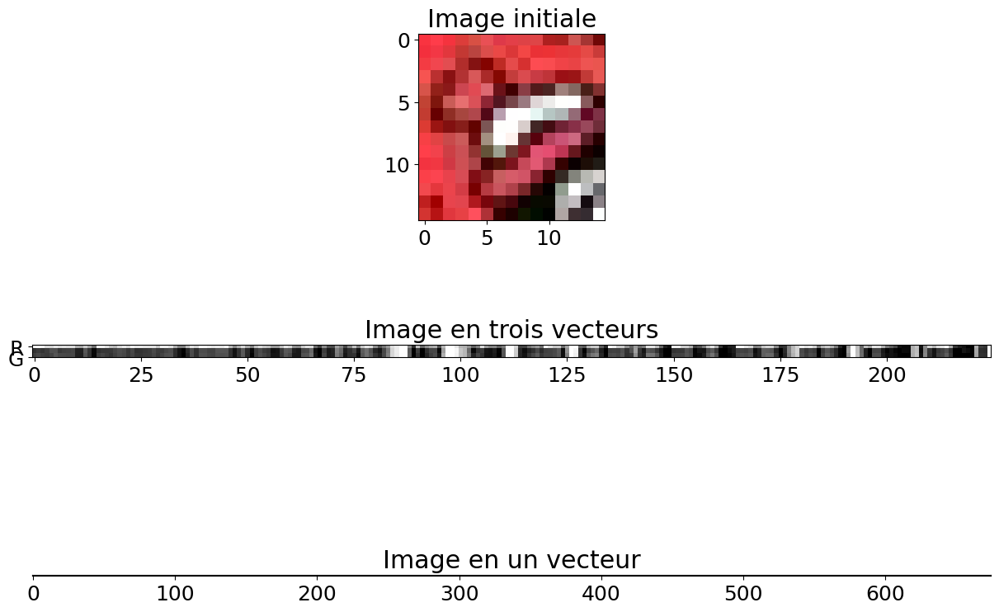

In [30]:
# Transform image into vector to make it compatible with fully-connected neural network
waldo = complete_image2[20:35,950:965]
waldo_vector = waldo.ravel()

print(f'Taille initiale: {waldo.shape}')
print(f'Taille modifiée: {waldo_vector.shape}')

# Expand dimension of vector for display
waldo_vector = np.expand_dims(waldo_vector,0)
waldo_vector = np.repeat(waldo_vector, 1, 0)
print(f'Taille modifiée: {waldo_vector.shape}')

# Expand into three (RGB) vectors
waldo_three_vectors = np.zeros((3,waldo.shape[0]*waldo.shape[1]))
for i in range(3):
    waldo_three_vectors[i,:] = waldo[:,:,i].ravel()

# Display
fig, axs = plt.subplots(3,1,figsize=(15,10))

axs[0].imshow(waldo)
axs[0].set_title('Image initiale')
axs[1].imshow(waldo_three_vectors,vmin=0,vmax=255,cmap='gist_gray')
axs[1].set_title('Image en trois vecteurs')
axs[1].set_yticklabels(['','R','G','B'])
axs[2].imshow(waldo_vector,cmap='gist_gray')
axs[2].set_title('Image en un vecteur')
axs[2].set_yticks([])

## Réseau de neurones à convolution / Convolution neural network (CNN)

Le réseau neuronal à convolution applique séquentiellement des convolutions à une image. Le nombre d'opérations par couche, le nombre de couches et les paramètres de la convolution sont fixes, mais les poids et les biais des convolutions sont appris lors de la formation.

La section de code suivante illustre l'apprentissage de ces poids et biais en comparant des filtres de convolution AlexNet initialisés de manière aléatoire et ces mêmes filtres après formation.

<img src="https://www.mdpi.com/remotesensing/remotesensing-09-00848/article_deploy/html/images/remotesensing-09-00848-g001-550.jpg" width="800" align="center"/>

Source: Han, X., Zhong, Y., Cao, L., & Zhang, L. (2017). Pre-trained alexnet architecture with pyramid pooling and supervision for high spatial resolution remote sensing image scene classification. *Remote Sensing, 9*(8), 848.

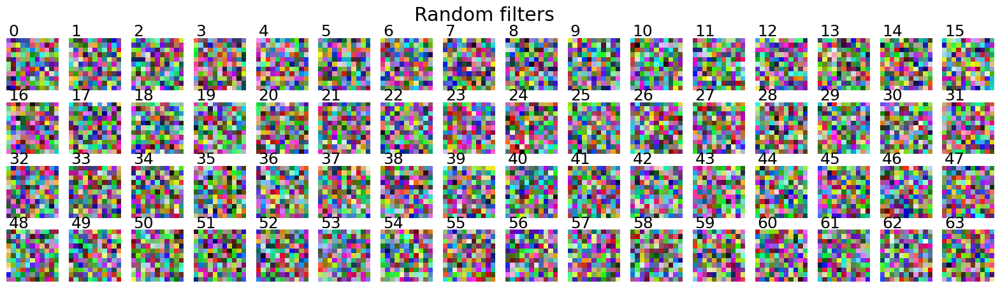

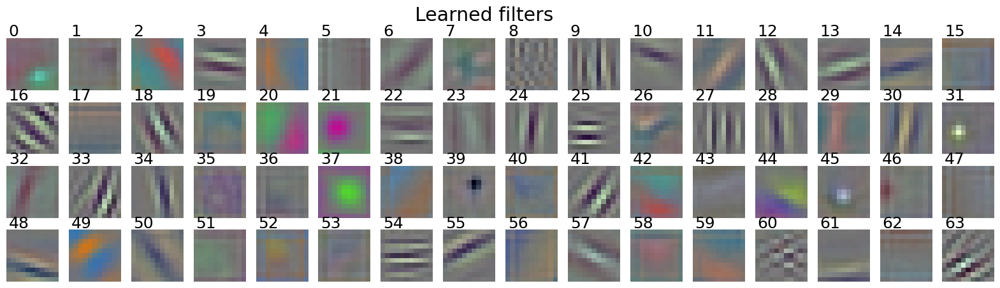

In [50]:
def plot_weights(model, layer_num, title=""):

  #extracting the model features at the particular layer number
  layer = model.features[layer_num]

  #checking whether the layer is convolution layer or not
  if isinstance(layer, nn.Conv2d):
    #getting the weight tensor data
    weight_tensor = model.features[layer_num].weight.data

    #normalize weight_tensor between 0 and 1.0 for visualization
    weight_tensor = ((weight_tensor-weight_tensor.min()) / (weight_tensor.max()-weight_tensor.min()) * 1.0)

    #switch order of channels to fit with matplotlib (torch uses CxHxW, matplotlib uses HxWxC)
    weight_tensor = weight_tensor.permute(0,2,3,1)

    fig, axs = plt.subplots(4,16, figsize=(20,5)) # we stop at 64 filters
    for idx in range(min(weight_tensor.shape[0],64)):
      axs.ravel()[idx].imshow(weight_tensor[idx,:,:,:3])
      axs.ravel()[idx].text(0,-1,s=str(idx))
      axs.ravel()[idx].axis('off')
    plt.suptitle(title)
    plt.show()
  else:
    print("Can only visualize layers which are convolutional")

# Visualize weights for alexnet
# Select layer for which weights will be visualized
# [0, 3, 6, 8, 10]
layer = 0
alexnet = models.alexnet(pretrained=False)
plot_weights(alexnet, layer, title="Random filters")
alexnet_trained = models.alexnet(pretrained=True)
plot_weights(alexnet_trained, layer, title="Learned filters")

Maintenant, visualisons le résultat de ces filtres appliqués sur une image! On remarque bien qu'un filtre aléatoire ne met pas en valeur d'éléments précis, mais les filtres appris font ressortir des éléments de base comme les lignes, les ronds, les motifs quadrillés, etc.

Changez la variable "filtre_idx" pour appliquer le filtre de votre choix, en référence aux numéros de filtre de la cellule précédente.

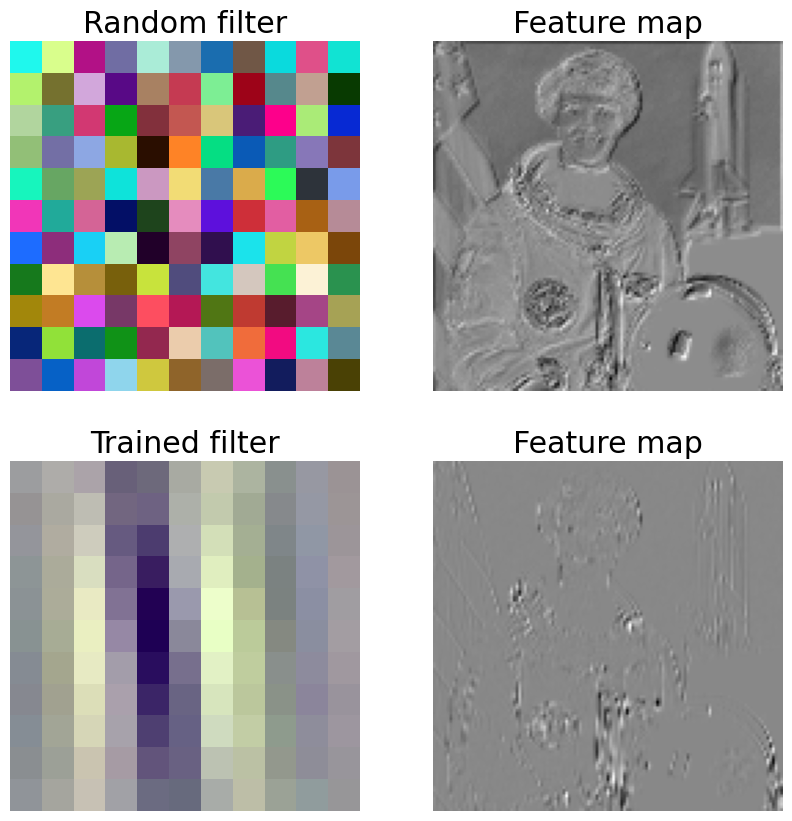

In [51]:
#---Choose the filter to apply [0,63]--#
filter_idx = 28
#--------------------------------------#

# Image
im = torch.tensor(skimage.data.astronaut()).unsqueeze(0)
im = im.permute(0,3,1,2).float()

# Aplly first convolution layer from AlexNet to image
im_conv_nottrained = alexnet.features[:1](im)
im_conv_trained = alexnet_trained.features[:1](im)

fig, axs = plt.subplots(2,2,figsize=(10,10))

# Random filter
filter_nottrained = alexnet.features[0].weight[filter_idx].permute(1,2,0).detach().numpy()
filter_nottrained = (filter_nottrained-filter_nottrained.min())/(filter_nottrained.max()-filter_nottrained.min())
axs[0,0].imshow(filter_nottrained)
axs[0,0].set_title('Random filter')
axs[0,1].imshow(im_conv_nottrained[0,filter_idx,...].detach().numpy(),cmap='gist_gray')
axs[0,1].set_title('Feature map')

# Trained filter
filter_trained = alexnet_trained.features[0].weight[filter_idx].permute(1,2,0).detach().numpy()
filter_trained = (filter_trained-filter_trained.min())/(filter_trained.max()-filter_trained.min())
axs[1,0].imshow(filter_trained)
axs[1,0].set_title('Trained filter')
axs[1,1].imshow(im_conv_trained[0,filter_idx,...].detach().numpy(),cmap='gist_gray')
axs[1,1].set_title('Feature map')

for ax in axs.ravel():
  ax.axis('off')

(-0.5, 511.5, 511.5, -0.5)

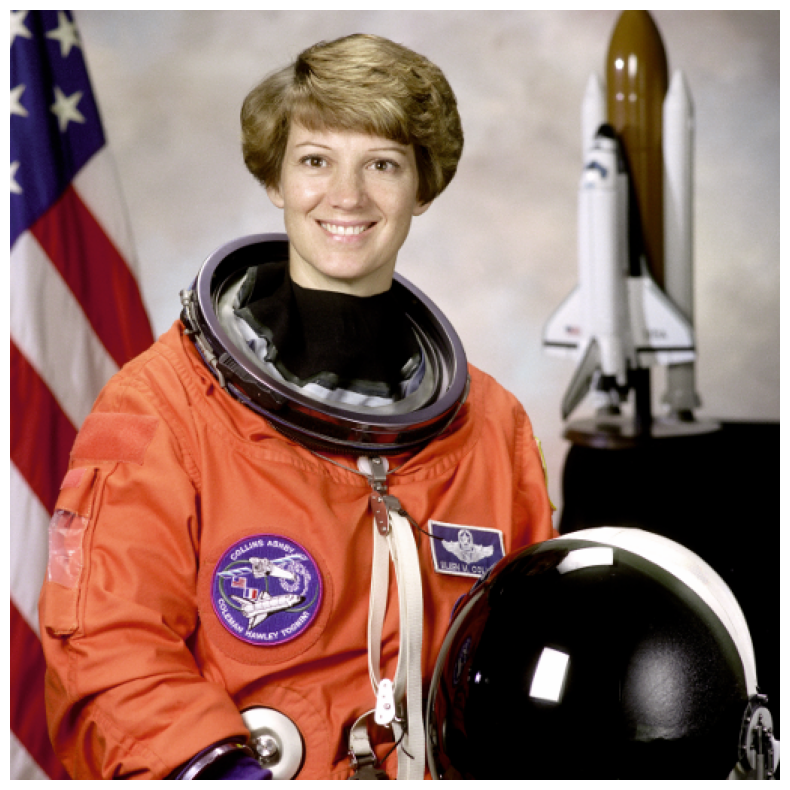

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(10,10))
ax.imshow(skimage.data.astronaut())
ax.axis('off')

Text(50, 85, 'Lip?')

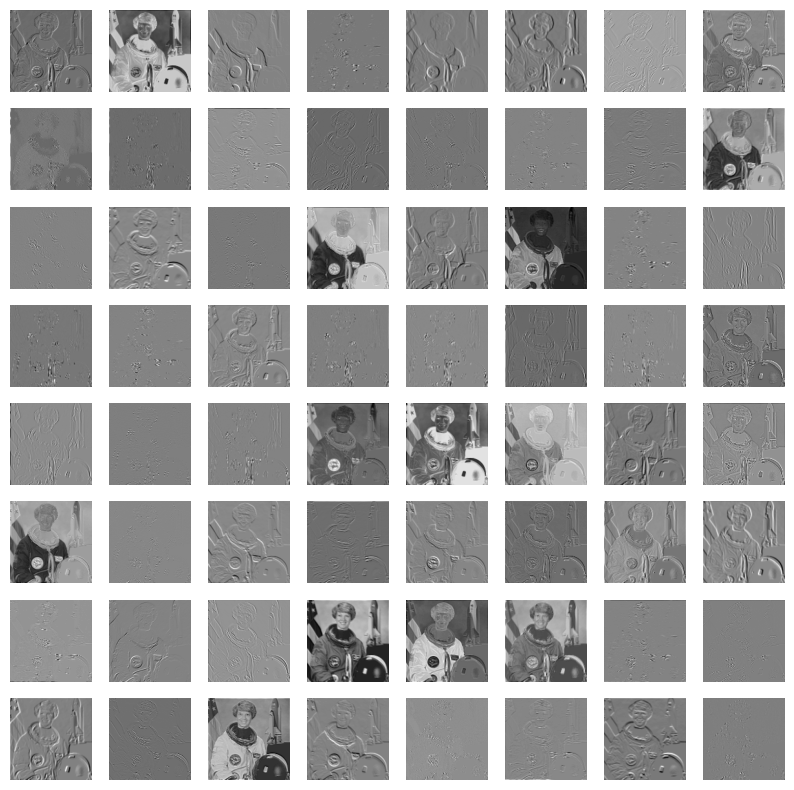

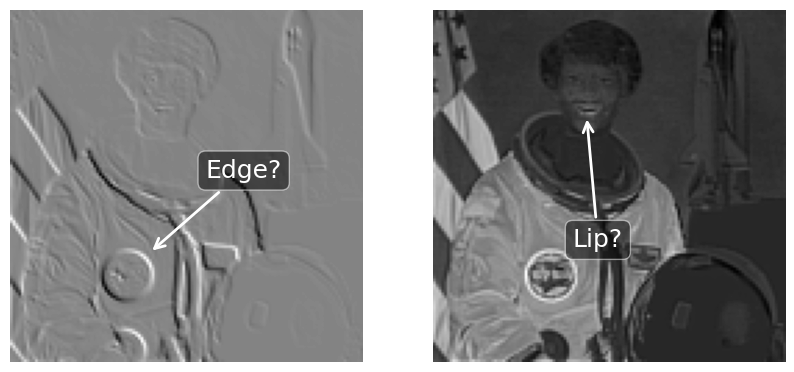

In [52]:
# Display all feature maps from first convolution layer of AlexNet

fig, axs = plt.subplots(8,8,figsize=(10,10))
for i, ax in enumerate(axs.ravel()):
  ax.imshow(im_conv_trained[0,i,...].detach().numpy(),cmap='gist_gray')
  ax.axis('off')

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
for i, (ax, to_show) in enumerate(zip(axs, (2, 21))):
  ax.imshow(im_conv_trained[0, to_show].detach(), cmap='gist_gray')
  ax.axis('off')
axs[0].annotate('Edge?', (50, 87), (70, 60),
                color='w',
                arrowprops={'arrowstyle':'->', 'linewidth': 2, 'color':'w'},
                bbox=dict(facecolor='black', alpha=0.5, edgecolor='w', boxstyle='round'))
axs[1].annotate('Lip?', (55, 38), (50, 85),
                color='w',
                arrowprops={'arrowstyle':'->', 'linewidth': 2, 'color':'w'},
                bbox=dict(facecolor='black', alpha=0.5, edgecolor='w', boxstyle='round'))

Exemples d'images qui activent ces filtres:

<img src="https://media5.datahacker.rs/2021/11/image-70.png">

<img src="https://media5.datahacker.rs/2021/11/image-71-1024x496.png">

Source : [PyTorch – Visualization of Convolutional Neural Networks in PyTorch](https://datahacker.rs/028-visualization-and-understanding-of-convolutional-neural-networks-in-pytorch/)

## Apprentissage des filtres

<img src="https://www.researchgate.net/publication/331540139/figure/fig4/AS:733273504354306@1551837435967/The-overall-architecture-of-the-Convolutional-Neural-Network-CNN-includes-an-input.png" width="800" align="center"/>

Les valeurs des filtres du réseau de convolution sont apprises en comparant la sortie du réseau à la vérité terrain. La *vérité terrain* est constituée par les étiquettes créées manuellement par un expert a priori de la formation du réseau (formation supervisée).

Dans la cellule de code suivante, nous pouvons visualiser les filtres appris par un réseau. En augmentant la variable **cnn_layer** pour visualiser les couches plus profondes du réseau, nous pouvons clairement observer que les caractéristiques mises en évidence par les filtres deviennent plus complexes par l'application de plusieurs filtres en cascade. A l'inverse, pour les premières couches du réseau, les caractéristiques sont beaucoup plus simples.

Ici, le réseau est déjà entraîné, nous n'optimisons donc pas ses poids. Au contraire, nous optimisons l'image d'entrée pour maximiser l'activation du filtre choisi. Pour plus d'informations, je vous recommande absolument de consulter la source de la méthode : [How to visualize convolutional features in 40 lines of code](https://towardsdatascience.com/how-to-visualize-convolutional-features-in-40-lines-of-code-70b7d87b0030).


Iteration: 0 Loss: -15.52
Iteration: 1 Loss: -56.47
Iteration: 2 Loss: -81.94
Iteration: 3 Loss: -110.10
Iteration: 4 Loss: -125.35


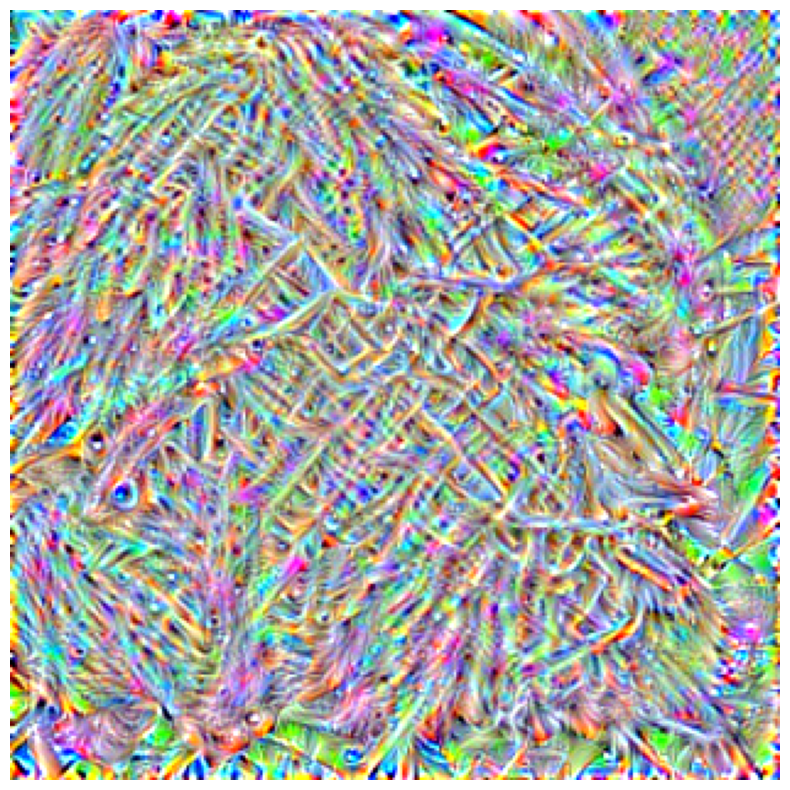

In [58]:
# Source: https://github.com/utkuozbulak/pytorch-cnn-visualizations
# Source: https://towardsdatascience.com/how-to-visualize-convolutional-features-in-40-lines-of-code-70b7d87b0030

def save_image(im, path):
    """
        Saves a numpy matrix or PIL image as an image
    Args:
        im_as_arr (Numpy array): Matrix of shape DxWxH
        path (str): Path to the image
    """
    if isinstance(im, (np.ndarray, np.generic)):
        im = format_np_output(im)
        im = Image.fromarray(im)
    im.save(path)


def preprocess_image(pil_im, resize_im=True):
    """
        Processes image for CNNs
    Args:
        PIL_img (PIL_img): PIL Image or numpy array to process
        resize_im (bool): Resize to 224 or not
    returns:
        im_as_var (torch variable): Variable that contains processed float tensor
    """
    # mean and std list for channels (Imagenet)
    mean = [0.485, 0.456, 0.406]
    std = [0.229, 0.224, 0.225]

    #ensure or transform incoming image to PIL image
    if type(pil_im) != Image.Image:
        try:
            pil_im = Image.fromarray(pil_im)
        except Exception as e:
            print("could not transform PIL_img to a PIL Image object. Please check input.")

    # Resize image
    if resize_im:
        pil_im = pil_im.resize((224, 224), Image.ANTIALIAS)

    im_as_arr = np.float32(pil_im)
    im_as_arr = im_as_arr.transpose(2, 0, 1)  # Convert array to D,W,H
    # Normalize the channels
    for channel, _ in enumerate(im_as_arr):
        im_as_arr[channel] /= 255
        im_as_arr[channel] -= mean[channel]
        im_as_arr[channel] /= std[channel]
    # Convert to float tensor
    im_as_ten = torch.from_numpy(im_as_arr).float()
    # Add one more channel to the beginning. Tensor shape = 1,3,224,224
    im_as_ten.unsqueeze_(0)
    # Convert to Pytorch variable
    im_as_var = Variable(im_as_ten, requires_grad=True)
    return im_as_var


def recreate_image(im_as_var):
    """
        Recreates images from a torch variable, sort of reverse preprocessing
    Args:
        im_as_var (torch variable): Image to recreate
    returns:
        recreated_im (numpy arr): Recreated image in array
    """
    reverse_mean = [-0.485, -0.456, -0.406]
    reverse_std = [1/0.229, 1/0.224, 1/0.225]
    recreated_im = copy.copy(im_as_var.data.numpy()[0])
    for c in range(3):
        recreated_im[c] /= reverse_std[c]
        recreated_im[c] -= reverse_mean[c]
    recreated_im[recreated_im > 1] = 1
    recreated_im[recreated_im < 0] = 0
    recreated_im = np.round(recreated_im * 255)

    recreated_im = np.uint8(recreated_im).transpose(1, 2, 0)
    return recreated_im

def format_np_output(np_arr):
    """
        This is a (kind of) bandaid fix to streamline saving procedure.
        It converts all the outputs to the same format which is 3xWxH
        with using sucecssive if clauses.
    Args:
        im_as_arr (Numpy array): Matrix of shape 1xWxH or WxH or 3xWxH
    """
    # Phase/Case 1: The np arr only has 2 dimensions
    # Result: Add a dimension at the beginning
    if len(np_arr.shape) == 2:
        np_arr = np.expand_dims(np_arr, axis=0)
    # Phase/Case 2: Np arr has only 1 channel (assuming first dim is channel)
    # Result: Repeat first channel and convert 1xWxH to 3xWxH
    if np_arr.shape[0] == 1:
        np_arr = np.repeat(np_arr, 3, axis=0)
    # Phase/Case 3: Np arr is of shape 3xWxH
    # Result: Convert it to WxHx3 in order to make it saveable by PIL
    if np_arr.shape[0] == 3:
        np_arr = np_arr.transpose(1, 2, 0)
    # Phase/Case 4: NP arr is normalized between 0-1
    # Result: Multiply with 255 and change type to make it saveable by PIL
    if np.max(np_arr) <= 1:
        np_arr = (np_arr*255).astype(np.uint8)
    return np_arr


class CNNLayerVisualization():
    """
        Produces an image that minimizes the loss of a convolution
        operation for a specific layer and filter
    """
    def __init__(self, model, selected_layer, selected_filter):
        self.model = model
        self.model.eval()
        self.selected_layer = selected_layer
        self.selected_filter = selected_filter
        self.conv_output = 0

    def hook_layer(self):
        def hook_function(module, grad_in, grad_out):
            # Gets the conv output of the selected filter (from selected layer)
            self.conv_output = grad_out[0, self.selected_filter]
        # Hook the selected layer
        self.model[self.selected_layer].register_forward_hook(hook_function)

    def visualise_layer_with_hooks(self):
        # Hook the selected layer
        self.hook_layer()
        # Generate a random image
        sz = 128
        random_image = np.uint8(np.random.uniform(150, 180, (sz, sz, 3)))
        # Process image and return variable
        processed_image = preprocess_image(random_image, False)
        for j in range(5): # Increase the number of iterations to get a better resolution (but requires more computing time)
          # Define optimizer for the image
          optimizer = Adam([processed_image], lr=0.1, weight_decay=1e-6)
          for i in range(1, 11):
              optimizer.zero_grad()
              # Assign create image to a variable to move forward in the model
              x = processed_image
              for index, layer in enumerate(self.model):
                  # Forward pass layer by layer
                  # x is not used after this point because it is only needed to trigger
                  # the forward hook function
                  x = layer(x)
                  # Only need to forward until the selected layer is reached
                  if index == self.selected_layer:
                      # (forward hook function triggered)
                      break
              # Loss function is the mean of the output of the selected layer/filter
              # We try to minimize the mean of the output of that specific filter
              loss = -torch.mean(self.conv_output)
              # Backward
              loss.backward()
              # Update image
              optimizer.step()
          print('Iteration:', str(j), 'Loss:', "{0:.2f}".format(loss.data.numpy()))
          # Rescale image by factor 1.2
          sz = int(1.2 * sz)
          processed_image = processed_image.detach().numpy()
          processed_image = processed_image[0].transpose(1,2,0)
          processed_image = cv2.resize(processed_image, (sz, sz), interpolation = cv2.INTER_CUBIC)
          processed_image = torch.tensor(processed_image).permute(2,0,1).unsqueeze(0)
          processed_image.requires_grad = True
        # Recreate image
        self.created_image = recreate_image(processed_image)
        fig, ax = plt.subplots(1,1,figsize=(10,10))
        ax.imshow(self.created_image)
        ax.axis('off')

#---Paramètres---#
# Chicken : 28 / 457
# Squirrel : 28 /121
# Frog : 28 / 341
# La complexité des filtres augmente avec la prodondeur de la convolution (cnn_layer)
cnn_layer = 28 # choose between 0, 2, 5, 7, 10, 12, 14, 17, 19, 21, 24, 26, 28
filter_pos = 96 # [0,63] if cnn_layer = (0,2), [0,127] if cnn_layer = (5,7), [0,255] if cnn_layer = (10,12,14), [0,511] otherwise
#----------------#

# Fully connected layer is not needed
pretrained_model = models.vgg16(pretrained=True).features
layer_vis = CNNLayerVisualization(pretrained_model, cnn_layer, filter_pos)

# Layer visualization with pytorch hooks
layer_vis.visualise_layer_with_hooks()


mongoose


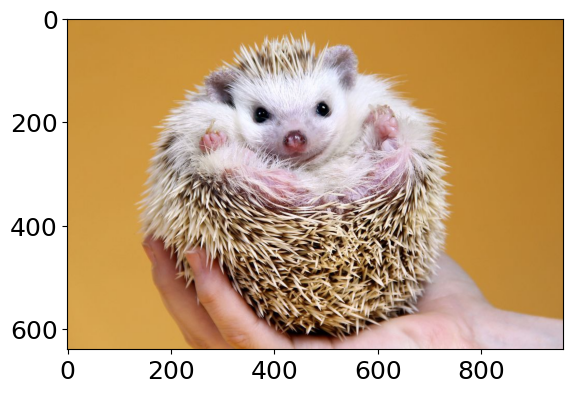

In [56]:
# Define model
model = models.vgg16(pretrained=True)

# Function to convert network predictions into class labels
class_idx = json.load(open('imagenet_class_index.json'))
idx2label = [class_idx[str(k)][1] for k in range(len(class_idx))]

# Quels filtres sont activés par une image donnée
#image = imageio.imread('frog.jpeg')
image = Image.open('images/herisson.jpg')

# Display the image
fig, ax = plt.subplots()
ax.imshow(image)

# Convertir l'image de numpy array à torch tensor [c,h,w]
#image = torch.tensor(image.transpose((2,0,1)))

# Transformations
normalize = torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])

transform = torchvision.transforms.Compose([
        torchvision.transforms.Resize(256),
        torchvision.transforms.CenterCrop(256),
        torchvision.transforms.ToTensor(),
        normalize])

image = transform(image).unsqueeze(0)
image = Variable(image)

output = model(image)

# Print the prediction
print(idx2label[output.argmax()])

Most activated filters:  [ 96 461 109]


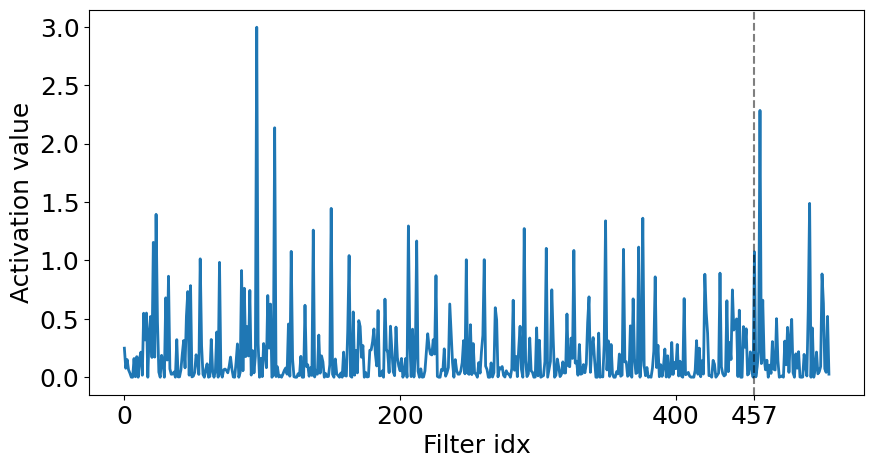

In [57]:
model_crop = model.features[:cnn_layer+2]

feature_maps = model_crop(image)

activation_list = []
for cnn_filter in range(feature_maps.shape[1]):
    activation_list.append(feature_maps[0,cnn_filter].mean().item())

fig, axs = plt.subplots(figsize=(10,5))
plt.plot(activation_list,linewidth=2.)
plt.xlabel('Filter idx')
plt.ylabel('Activation value')
plt.axvline(x=filter_pos, color='k', linestyle='--',alpha=0.5)
axs.set_xticks([0,200,400] + [filter_pos])

#----------#
n = 3 # Number of filters to print
#----------#
print('Most activated filters: ', np.argsort(activation_list)[-n:][::-1])

Pour plus d'exemples et l'explication du fonctionnement: [How to visualize convolutional features in 40 lines of code](https://towardsdatascience.com/how-to-visualize-convolutional-features-in-40-lines-of-code-70b7d87b0030)

<table><tr>
<td> <img src="https://miro.medium.com/max/276/1*sLZBebq-3QjUSchP8Sn2Kg.jpeg" width="500"/></td>
<td> <img src="https://miro.medium.com/max/408/1*kME_uQu_elNyNfgTY-7xpQ.jpeg" width="500"/> </td>
<td> <img src="https://miro.medium.com/max/408/1*MznCLV-oe3_HAXzbojw-zg.jpeg" width="500"/> </td>
<td> <img src="https://miro.medium.com/max/408/1*A8-RygaInWt8LBHXO7H05Q.jpeg" width="500"/> </td>
<td> <img src="https://miro.medium.com/max/408/1*JcWSiiLzvNDQB7rIAgTYlg.jpeg" width="500"/> </td>
</tr></table>

Et : [PyTorch – Visualization of Convolutional Neural Networks in PyTorch](https://datahacker.rs/028-visualization-and-understanding-of-convolutional-neural-networks-in-pytorch/)


## Paramètres de convolution

La convolution est définie par 4 paramètres :

- Taille du noyau : La taille, en pixels, d'un côté du filtre. Bien qu'il soit possible d'appliquer une convolution avec un filtre non carré, c'est généralement la géométrie qui est utilisée dans le CNN.
- Stride (enjambement) : Le déplacement en pixels entre chaque opération
- Padding (remplissage) : Tant que le filtre a une taille supérieure à 1x1, le résultat de la convolution aura une taille inférieure à l'image originale. Un padding sur le bord de l'image est souvent ajouté pour que le résultat ait la même taille que l'image originale.
- Dilatation : L'espacement entre les pixels dans la section de l'image à laquelle le filtre est appliqué.

Ces paramètres sont présentés visuellement dans la section suivante.

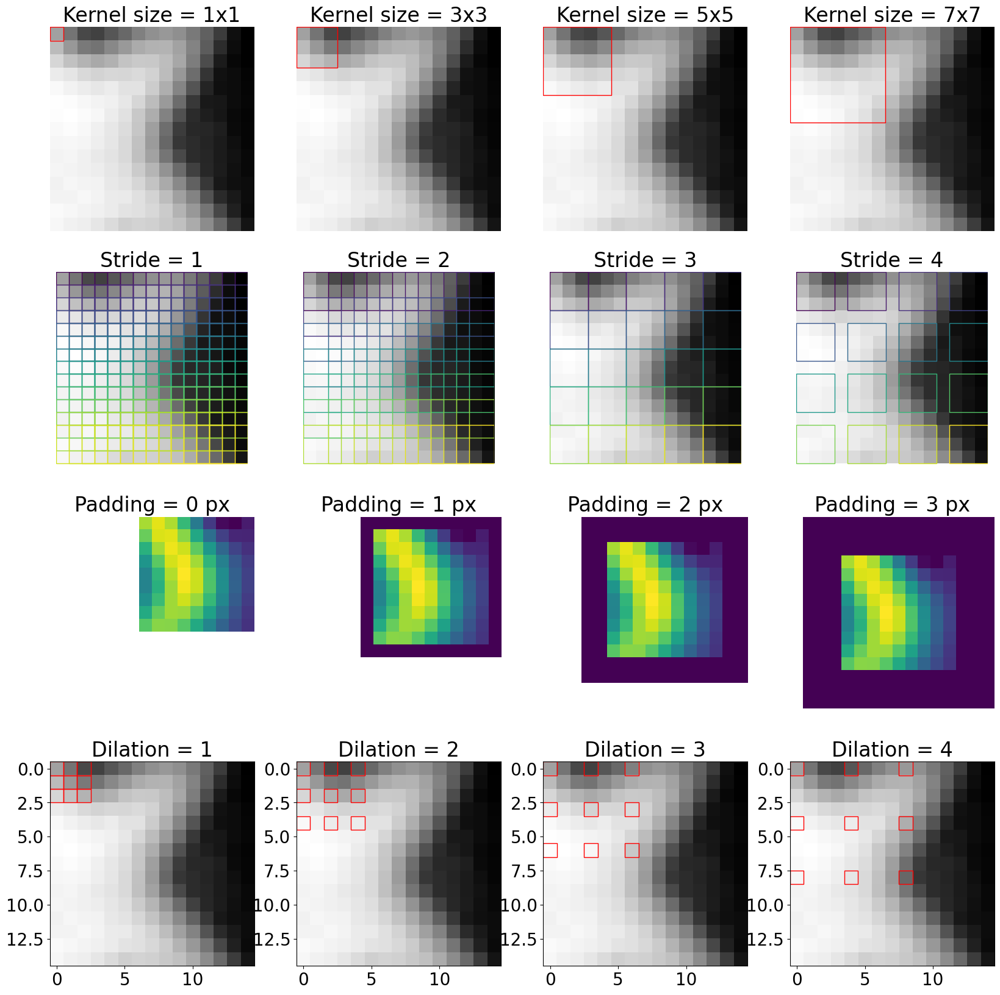

In [65]:
crop_size = 15
im = np.mean(skimage.data.astronaut(),axis=2)[:crop_size,:crop_size]

#---Kernel size---#
kernel_size_list = [1,3,5,7]
#-----------------#

fig, axs = plt.subplots(4,4,figsize=(20,20))

for ax, kernel_size in zip(axs[0].ravel(), kernel_size_list):
  ax.imshow(im,cmap='gist_gray')
  filter = matplotlib.patches.Rectangle((-0.5,-0.5), width=kernel_size, height=kernel_size, linewidth=1, edgecolor='r', facecolor='none')
  ax.add_patch(filter)
  ax.axis('off')
  ax.set_ylim(14.5,-0.5)
  ax.set_title('Kernel size = {}x{}'.format(kernel_size,kernel_size))

#---Stride---#
stride_list = [1,2,3,4]
#------------#

for ax, stride in zip(axs[1].ravel(), stride_list):
  color_idx = 0
  color_range = len(range(0,im.shape[0]-2,stride))*len(range(0,im.shape[1]-2,stride))
  viridis = matplotlib.cm.get_cmap('viridis', color_range)
  ax.imshow(im, cmap='gist_gray')
  for i in range(0,im.shape[0]-2,stride):
    for j in range(0,im.shape[1]-2,stride):
      filter = matplotlib.patches.Rectangle((j-0.5,i-0.5), width=3, height=3, linewidth=1, edgecolor=viridis(color_idx), facecolor='none')
      color_idx += 1/color_range
      ax.add_patch(filter)
  ax.axis('off')
  ax.set_ylim(15.5,-0.5)
  ax.set_title('Stride = {}'.format(stride))

#---Padding---#
padding_list = [0,1,2,3]
#-------------#

filter = custom_sobel((7,7), 0)
conv_result = scipy.signal.convolve2d(im, filter, mode='valid')

for ax, padding in zip(axs[2].ravel(), padding_list):
  conv_result_padded = np.pad(conv_result, padding)
  ax.imshow(conv_result_padded, cmap='viridis')
  ax.set_ylim(15.5,-0.5)
  ax.set_xlim(15.5,-0.5)
  ax.set_title('Padding = {} px'.format(padding))
  ax.axis('off')

#---Dilation---#
dilation_list = [1,2,3,4]
#--------------#

for ax, dilation in zip(axs[3].ravel(), dilation_list):
  ax.imshow(im, cmap='gist_gray')
  for i in range(3):
    for j in range(3):
      px = matplotlib.patches.Rectangle((j-0.5+j*(dilation-1),i-0.5+i*(dilation-1)), width=1, height=1, linewidth=1, edgecolor='r', facecolor='none')
      ax.add_patch(px)
  ax.set_title('Dilation = {}'.format(dilation))

plt.show()

### Couches de *Pooling*

<img src="https://production-media.paperswithcode.com/methods/MaxpoolSample2.png">

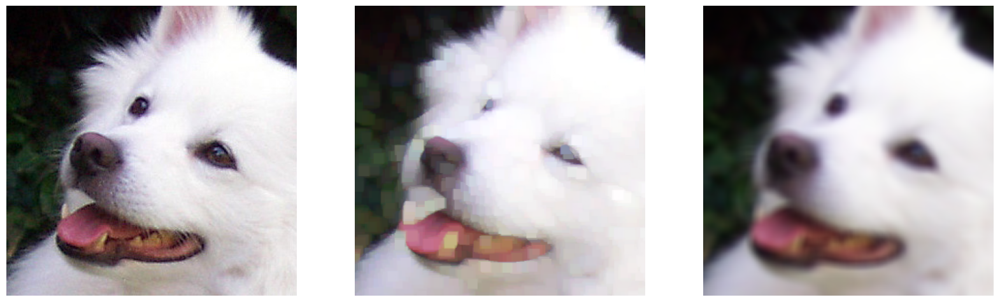

In [66]:
#--Parameters--#
kernel = 10
stride = 1
random_input = False
#--------------#

if random_input:
    # Random input
    input = torch.randn(1, 1, 100, 100)
else:
    # Or, load a dog image from pytorch site
    url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg", "dog.jpg")
    urllib.request.urlretrieve(url, filename)

    transform = transforms.Compose([
        transforms.ToTensor()
    ])

    # Convert the dog PIL image to Torch tensor
    dog = Image.open(filename)
    dog = transform(dog)

    # Crop it's cute face
    input = dog[:,100:400,200:500]

# Max Pooling
m = nn.MaxPool2d(kernel, stride=stride)
output_m = m(input)

# Mean Pooling
a = nn.AvgPool2d(kernel, stride=stride)
output_a = a(input)

# Display
fig, axs = plt.subplots(1,3,figsize=(20,10))
if not random_input:
    input = input.transpose(0,2).transpose(0,1)
    output_a = output_a.transpose(0,2).transpose(0,1)
    output_m = output_m.transpose(0,2).transpose(0,1)

axs[0].imshow(input.squeeze())
axs[1].imshow(output_m.squeeze())
axs[2].imshow(output_a.squeeze())

for ax in axs:
    ax.axis('off')

## Les mécanismes d'attention

L'attention est un mécanisme qui permet aux réseaux neuronaux de se concentrer sur des parties spécifiques des données en entrée.

#### Visualisation de l'activation du gradient

Source: Selvaraju, R. R., Cogswell, M., Das, A., Vedantam, R., Parikh, D., & Batra, D. (2017). Grad-cam: Visual explanations from deep networks via gradient-based localization. In *Proceedings of the IEEE international conference on computer vision* (pp. 618-626).

--2024-05-06 19:10:51--  https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10472 (10K) [text/plain]
Saving to: ‘imagenet_classes.txt.6’

imagenet_classes.tx 100%[===================>]  10.23K  --.-KB/s    in 0.001s  

2024-05-06 19:10:51 (11.6 MB/s) - ‘imagenet_classes.txt.6’ saved [10472/10472]



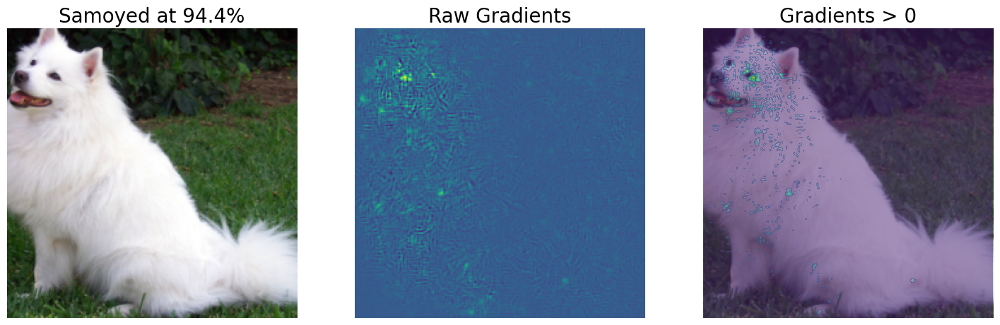

In [67]:
matplotlib.rcParams.update({'font.size': 20})

torch.manual_seed(42)

# Download ImageNet labels
!wget https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt

# Read the categories
with open("imagenet_classes.txt", "r") as f:
    categories = [s.strip() for s in f.readlines()]

# Load a dog image from pytorch site
url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg", "dog.jpg")
urllib.request.urlretrieve(url, filename)

# Dog image in the range 0 - 255
dog = Image.open(filename)

# Define image transformations
alexnet_stats = {
    'mean': [0.485, 0.456, 0.406],
    'std': [0.229, 0.224, 0.225]
} # see https://pytorch.org/hub/pytorch_vision_alexnet/
reshape = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
])
normalize = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(**alexnet_stats),
])

# Reshape the dog image to 224x224
dog = reshape(dog)
reshaped_dog = dog.copy()
# Normalize the intensity value of the dog image
dog = normalize(dog)
dog = dog.unsqueeze(0) # Create a mini-batch of 1 element

# Set the dog image to require gradients
dog.requires_grad = True

# Apply AlexNet to get a prediction on the image
output = alexnet_trained(dog)[0]

# ouput is a Tensor of shape 1000, with confidence scores over Imagenet's 1000 classes
# The output has unnormalized scores (not between 0 and 1).
# To get probabilities, we will run a softmax on it.
probabilities = torch.nn.functional.softmax(output, dim=0)

# We will get the indice with the highest probability
highest_probability_indice = torch.argmax(output)

# From that indice, we can retreive the predicted categorie
predicted_category = categories[highest_probability_indice]

# We will also retrieve the probability the network gave to this category
predicted_probability = probabilities[highest_probability_indice]

# Since we set the input image to require gradients, we can backprogated
# the gradients associated to the highest category to get a glimpse of which
# are influencing the prediction the most
output[highest_probability_indice].backward()
gradients = dog.grad.squeeze(0).numpy()
gradients = np.max(gradients, axis=0)

# Plotting
fig, axs = plt.subplots(1, 3, figsize=((18, 6)))
axs[0].imshow(reshaped_dog)
axs[0].set_title(f'{predicted_category} at {predicted_probability*100:.1f}%', fontsize=20)
axs[1].imshow(gradients, cmap='viridis')
axs[1].set_title('Raw Gradients', fontsize=20)
axs[2].imshow(reshaped_dog)

# Get a smoothed density map
x = np.arange(0, 224)
X, Y = np.meshgrid(x, x)
gradients[gradients < 0] = 0
axs[2].contourf(X, Y, gradients, alpha=0.5, levels=5)
axs[2].set_title('Gradients > 0', fontsize=20)

for ax in axs:
    ax.axis('off')

### Transformers

#### Attention is all you need

L'attention est importante dans l'apprentissage profond car elle améliore la capacité du modèle à capturer des modèles complexes dans la séquence d'entrée et a été la clé du succès de modèles tels que Transformers dans diverses tâches de NLP.

<img src="https://www.eidosmedia.com/resources/0267-11b1c10cf950-7d4b3fb33370-1000/transformer-trained-eidosmedia.png" width="800" align="center"/>

Vaswani, A., Shazeer, N., Parmar, N., Uszkoreit, J., Jones, L., Gomez, A. N., ... & Polosukhin, I. (2017). Attention is all you need. *Advances in neural information processing systems, 30*.

Negri, D., [Transformer NLP & Machine Learning: size does count, but size isn’t everything!](https://www.eidosmedia.com/updater/technology/machine-learning-size-isn-t-everything) 2021.



#### Vision Transformer

En vision numérique, il n'est pas nécessaire de s'appuyer sur les CNN; un *transformer* pur appliqué directement à des séquences d'images peut donner d'excellents résultats dans les tâches de classification d'images. Vision Transformer (ViT) obtient d'excellents résultats par rapport aux réseaux convolutionnels de pointe, tout en nécessitant beaucoup moins de ressources informatiques pour l'entraînement.

Dosovitskiy, A., Beyer, L., Kolesnikov, A., Weissenborn, D., Zhai, X., Unterthiner, T., ... & Houlsby, N. (2020). An image is worth 16x16 words: Transformers for image recognition at scale. *arXiv preprint arXiv:2010.11929*.

<img src="https://media.giphy.com/media/ATsWtUsuuFRfq8OhZ7/source.gif" width="800" align="center"/>

<img src="https://production-media.paperswithcode.com/methods/Screen_Shot_2021-01-26_at_9.43.31_PM_uI4jjMq.png" width="800" aligne="center"/>

# Appplications
<img src="https://149695847.v2.pressablecdn.com/wp-content/uploads/2020/07/u-net-segmentation-e1542978983391.png">

## Segmentation
Dans une tâche de segmentation, nous sommes intéressés par la classification de tous les pixels d'une image d'entrée.

Pour ce faire, tout comme pour la tâche de classification, la première section est utilisée pour l'extraction de caractéristiques. Celles-ci permettent au réseau de projeter l'image d'entrée dans un espace de caractéristiques abstrait. A partir de cet espace, des opérations sont effectuées pour revenir à l'espace d'origine, afin d'obtenir une représentation spatiale de ce que le réseau a détecté dans l'image d'origine.

Voici un exemple d'un tel réseau.
<img src='https://raw.githubusercontent.com/mateuszbuda/brain-segmentation-pytorch/master/assets/unet.png' width=500px>

In [64]:
from torchvision.io.image import read_image
from torchvision.models.segmentation import fcn_resnet50, FCN_ResNet50_Weights
from torchvision.transforms.functional import to_pil_image

# Load a dog image from pytorch site
url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg", "dog.jpg")
urllib.request.urlretrieve(url, filename)

# Dog image in the range 0 - 255
img = Image.open(filename)

# Step 1: Initialize model with the best available weights
weights = FCN_ResNet50_Weights.DEFAULT
model = fcn_resnet50(weights=weights)
model.eval()

# Step 2: Initialize the inference transforms
preprocess = weights.transforms()

# Step 3: Apply inference preprocessing transforms
batch = preprocess(img).unsqueeze(0)

# Step 4: Use the model and visualize the prediction
prediction = model(batch)["out"]
normalized_masks = prediction.softmax(dim=1)
class_to_idx = {cls: idx for (idx, cls) in enumerate(weights.meta["categories"])}
mask = normalized_masks[0, class_to_idx["dog"]]
to_pil_image(mask).show()

Downloading: "https://download.pytorch.org/models/fcn_resnet50_coco-1167a1af.pth" to /root/.cache/torch/hub/checkpoints/fcn_resnet50_coco-1167a1af.pth
100%|██████████| 135M/135M [00:08<00:00, 17.0MB/s]


Segment Anything : https://segment-anything.com/demo

Kirillov, A., Mintun, E., Ravi, N., Mao, H., Rolland, C., Gustafson, L., ... & Girshick, R. (2023). Segment anything. In *Proceedings of the IEEE/CVF International Conference on Computer Vision* (pp. 4015-4026).

## Classement


<img src='https://blog.acolyer.org/wp-content/uploads/2016/04/imagenet-fig4l.png'>

In [ ]:
net = torchvision.models.resnext50_32x4d(pretrained=True)

def load_dataset(path,shuffle=True,batch_size=8):
    normalize = torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
    transform = torchvision.transforms.Compose([
        torchvision.transforms.Resize(256),
        torchvision.transforms.CenterCrop(256),
        torchvision.transforms.ToTensor(),
        normalize])

    train_dataset = torchvision.datasets.ImageFolder(
        root=path,
        transform=transform
    )

    train_loader = torch.utils.data.DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=shuffle
    )
    return train_loader

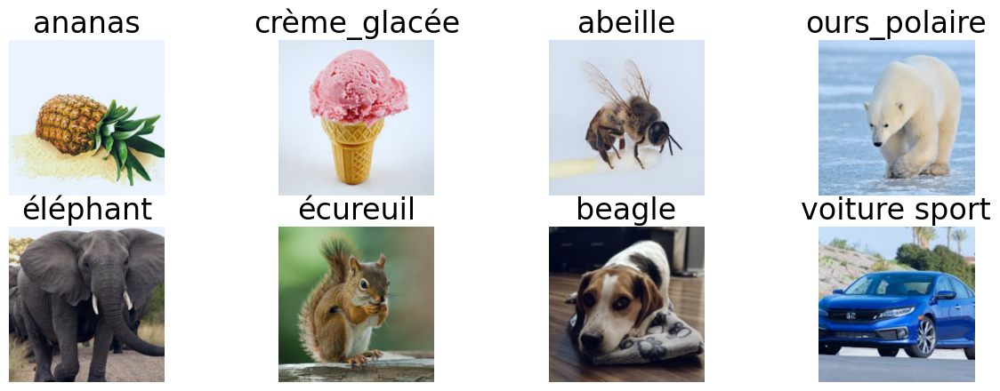

In [ ]:
# Bons exemples
net.eval()

import json
class_idx = json.load(open('imagenet_class_index.json'))
idx2label = [class_idx[str(k)][1] for k in range(len(class_idx))]

fig, axs = plt.subplots(2,4,figsize=(15,5))
for batch_idx, (data, target) in enumerate(load_dataset('images_classes/')):
    output = net(data)
    for i in range(8):
        im = data[i].permute(1,2,0)
        im = im-im.min()
        im = im/im.max()
        axs.ravel()[i].imshow(im)
        axs.ravel()[i].set_title(idx2label[output[i].argmax()])
        axs.ravel()[i].axis('off')
    break

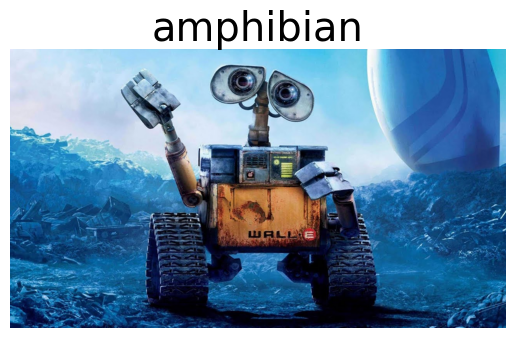

In [ ]:
# On peut le tester sur n'importe quoi!
image = os.listdir('nimporte_quoi/image')[0]
image = Image.open(os.path.join('nimporte_quoi/image',image))
plt.rcParams.update({'font.size': 24})
for batch_idx, (data, target) in enumerate(load_dataset('nimporte_quoi',shuffle=False, batch_size=1)):
    output = net(data)
    fig, axs = plt.subplots(1,1)
    axs.imshow(image)
    axs.set_title(idx2label[output[0].argmax()])
    axs.axis('off')
    break
plt.rcParams.update({'font.size': 16})

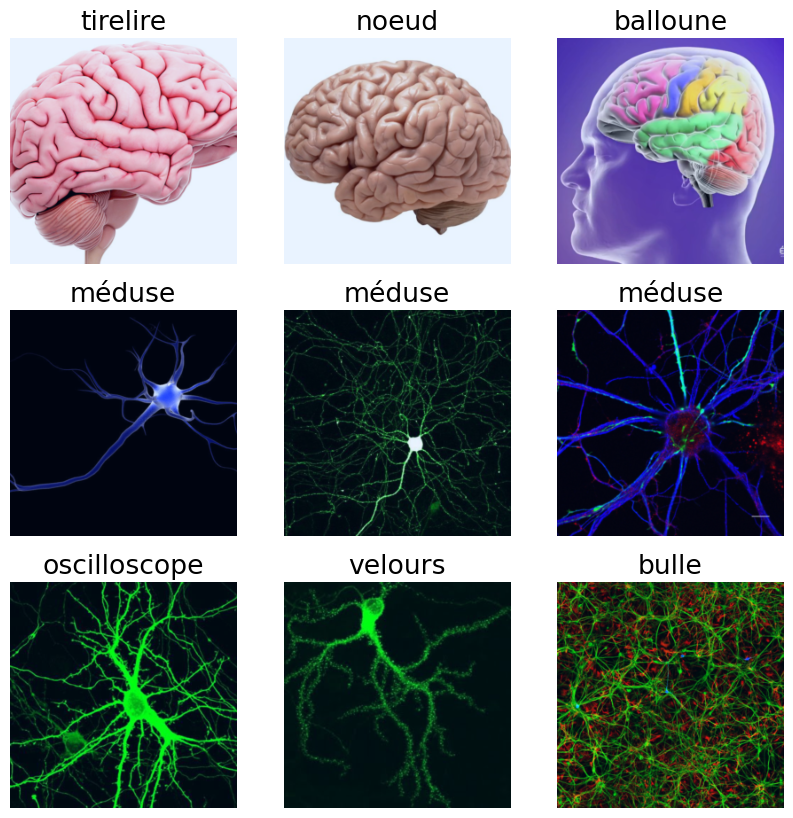

In [ ]:
# Mauvais exemples
for batch_idx, (data, target) in enumerate(load_dataset('images_nottrained',shuffle=False, batch_size=9)):
    output = net(data)
    fig, axs = plt.subplots(3,3,figsize=(10,10))
    for i in range(9):
        im = data[i].permute(1,2,0)
        im = im-im.min()
        im = im/im.max()
        axs.ravel()[i].imshow(im)
        axs.ravel()[i].set_title(idx2label[output[i].argmax()])
        axs.ravel()[i].axis('off')
    break

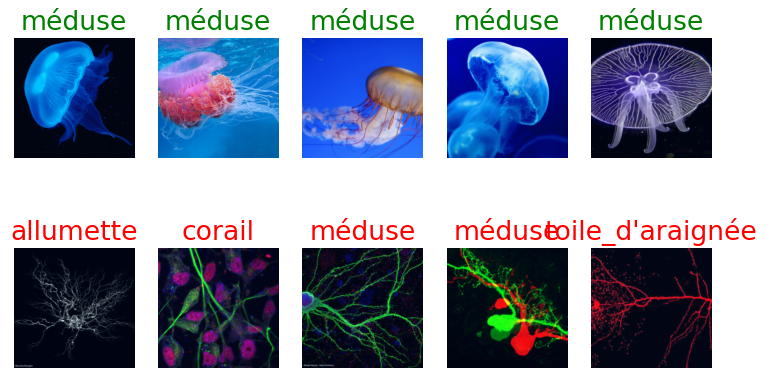

In [ ]:
# Le réseau ne fait pas la différence entre des neurones et des méduses!
fig, axs = plt.subplots(2,5,figsize=[9,5])
for batch_idx, (data, target) in enumerate(load_dataset('test_meduses_neurones',shuffle=False,batch_size=10)):
    pred = net(data)
    for i in range(10):
        im = data[i].permute(1,2,0)
        im = im-im.min()
        im = im/im.max()
        axs.ravel()[i].imshow(im)
        if pred[i].argmax() == 107 and target[i] == 0:
            color = 'g'
        else:
            color = 'r'
        axs.ravel()[i].set_title(idx2label[pred[i].argmax()],color=color)
        axs.ravel()[i].axis('off')
    break

Training accuracy @ epoch 0 : 78.1%
Training accuracy @ epoch 1 : 100.0%
Training accuracy @ epoch 2 : 100.0%


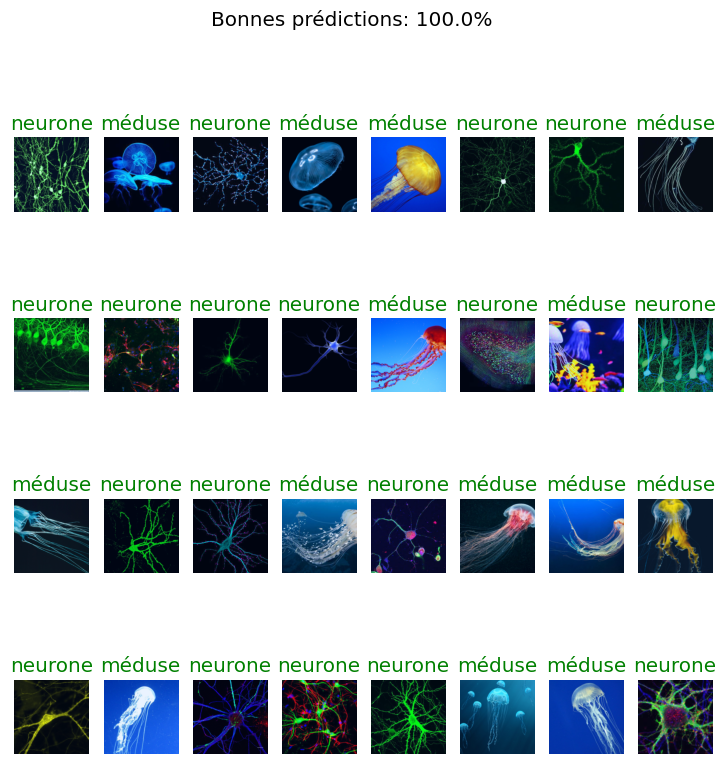

In [ ]:
# On va apprendre à un réseau à différencier des méduses et des neurones!
target_index = ['méduse', 'neurone']

for param in net.parameters():
    param.requires_grad = False

# Modification du réseau pour 2 classes
num_ftrs = net.fc.in_features
net2 = net
net2.fc = nn.Linear(num_ftrs, 2)

criterion = nn.CrossEntropyLoss()

# Optimizer
optimizer_conv = torch.optim.SGD(net.fc.parameters(), lr=0.001, momentum=0.9)

fig, ax = plt.subplots(4,8,figsize=[9,9])
plt.rcParams.update({'font.size': 12})
for epoch in range(3):
    j, good_preds = 0, 0
    for batch_idx, (data, target) in enumerate(load_dataset('images_meduses_neurones',shuffle=True)):
        pred = net2(data)
        loss = criterion(pred, target)
        optimizer_conv.zero_grad()
        loss.backward()
        optimizer_conv.step()
        for i in range(8):
            im = data[i].permute(1,2,0)
            im = im - im.min()
            im = im / im.max()
            ax[j,i].imshow(im)
            ax[j,i].axis('off')
            if pred[i].argmax() == target[i]:
                color = 'g'
                good_preds += 1
            else:
                color = 'r'
            ax[j,i].set_title('{}'.format(target_index[pred[i].argmax()]),color=color)
        j += 1
    print('Training accuracy @ epoch {} : {:.1f}%'.format(epoch, good_preds/32*100))
    plt.suptitle('Bonnes prédictions: {:.1f}%'.format(good_preds/32*100))

Text(0.5, 0.98, 'Bonnes prédictions: 100.0%')

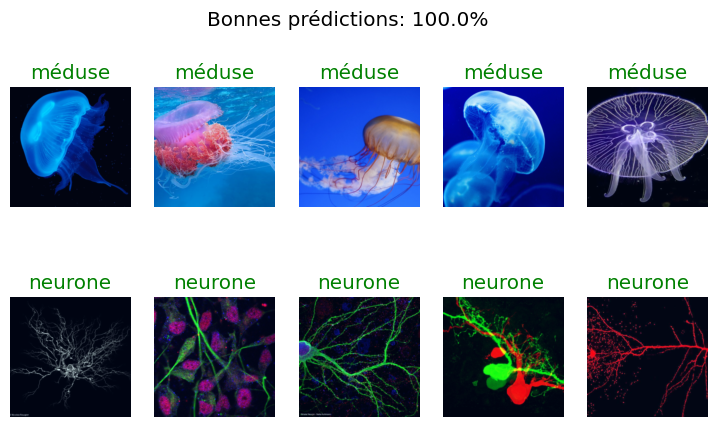

In [ ]:
# Puis vérifier si il a bien appris.
fig, axs = plt.subplots(2,5,figsize=[9,5])
for batch_idx, (data, target) in enumerate(load_dataset('test_meduses_neurones',shuffle=False,batch_size=10)):
    pred = net2(data)
    good_preds = 0
    for i in range(10):
        im = data[i].permute(1,2,0)
        im = im-im.min()
        im = im/im.max()
        axs.ravel()[i].imshow(im)
        if pred[i].argmax() == target[i]:
            color = 'g'
            good_preds += 1
        else:
            color = 'r'
        axs.ravel()[i].set_title(target_index[pred[i].argmax()],color=color)
        axs.ravel()[i].axis('off')
    break
plt.suptitle('Bonnes prédictions: {:.1f}%'.format(good_preds/10*100))



La classification d'images est un problème qui est maintenant considéré résolu.


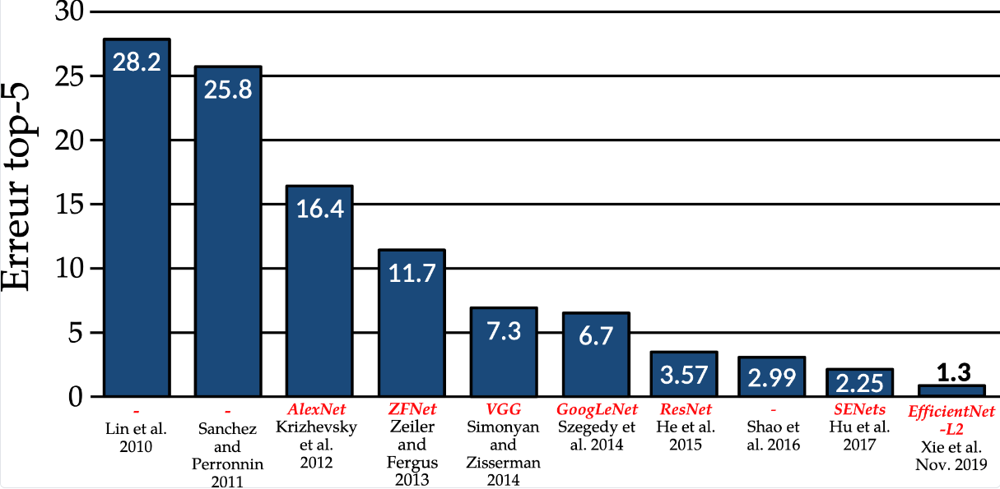


# Points de repère pratiques pour démarrer un projet d'apprentissage profond

### Vérifier si l'apprentissage profond se porte bien à la tâche
- Commencez par tester des méthodes d'apprentissage machine plus simples:
  - [Support Vector Machines (SVM)](https://scikit-learn.org/stable/modules/svm.html) <br><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/7/72/SVM_margin.png/300px-SVM_margin.png" width="200" align="center"/><br>
  - [Random forest](https://towardsdatascience.com/understanding-random-forest-58381e0602d2) <br><img src="https://i.stack.imgur.com/IvGZa.png" width="300" align="center"><br><br>
  - [Principal Component Analysis (PCA)](https://builtin.com/data-science/step-step-explanation-principal-component-analysis) <br> <br><img src="https://miro.medium.com/max/700/1*XFSxzNm2LWbVxKsHxkFwiQ.png" width="500" align="center"/><br>
  2D Scatter plot of MNIST data after applying PCA (n_components = 50) and then t-SNE (source: https://towardsdatascience.com/dimensionality-reduction-using-t-distributed-stochastic-neighbor-embedding-t-sne-on-the-mnist-9d36a3dd4521)<br><br>
  - [Threshold based segmentation](https://en.wikipedia.org/wiki/Thresholding_(image_processing))<br><img src="https://cdn.analyticsvidhya.com/wp-content/uploads/2019/03/cancer-cell-segmentation.png" width="300" align="center"/><br><br>
  - [Clustering](https://towardsdatascience.com/understanding-k-means-clustering-in-machine-learning-6a6e67336aa1)<br><img src="https://d2908q01vomqb2.cloudfront.net/f1f836cb4ea6efb2a0b1b99f41ad8b103eff4b59/2018/11/02/k-means-sagemaker-1.gif" width="300" align="center">
  - [Other classical methods](https://arxiv.org/ftp/arxiv/papers/1707/1707.02051.pdf).

### Définir la tâche
- Segmentation? Classification? Détection? Génération?
- Combien de classes? Quel type de segmentation? Sémantique, d'instance, binaire?

### Préparer les données
- Combien d'images sont disponibles? Quelles annotations sont disponibles?
- Est-ce que les classes sont bien balancées? Est-ce qu'elles devraient l'être?
- Quelles méthodes d'augementation de données sont applicables? Par exemples, les nombres ne sont pas invariants en rotation (un **6** à l'envers devrait être classé comme un **9**, mais son étiquette est **6**!)
<br>
<img src="https://i.stack.imgur.com/Momu1.jpg" width="300" align="left"/>
<br><br><br><br>

### Choisir l'architecture du réseau
- Est-ce qu'un réseau pré-entraîné pour la tâche est disponible? (e.g [torchvision] library (https://pytorch.org/vision/stable/models.html))
- Consultez la littérature pour identifier quel modèle est le plus performant pour votre tâche:
  - Classification, beaucoup d'images: [ResNeXt-101-32x8d](https://arxiv.org/abs/1611.05431v2)
  - Classification, peu d'images: [VGG-11](https://arxiv.org/abs/1409.1556), [AlexNet](https://arxiv.org/abs/1404.5997)
  - Segmentation: [U-Net](https://arxiv.org/abs/1505.04597)
  - Détection d'instance: [Mask-RCNN](https://arxiv.org/abs/1703.06870)

- Attention : les réseaux plus profonds sont généralement plus efficaces, mais leur formation nécessite beaucoup plus de données et de ressources informatiques.

### Sélection des hyper-paramètres + Entraîner le modèle
- Consultez les articles publiés qui utilisent une méthode similaire pour une tâche similaire et examinez les hyperparamètres utilisés.
- Si l'entraînement est efficace en termes de ressources et de temps, reproduisez plusieurs entraînements avec des hyperparamètres variables (recherche par grille).
- Examinez l'évolution des pertes de validation et d'apprentissage ; si les pertes oscillent beaucoup entre les époques, vous pouvez envisager de réduire le taux d'apprentissage ou d'augmenter la taille de batch. Si les pertes convergent mais pas les performances réelles, envisagez d'utiliser une fonction objectif différente, mieux adaptée à votre tâche spécifique.

<img src="https://forums.fast.ai/uploads/default/optimized/2X/5/5040a66e70fdc509e6b13a50ba78533009079c5a_2_690x426.png">
Source: https://forums.fast.ai/t/determining-when-you-are-overfitting-underfitting-or-just-right/7732/9

### Évaluer le modèle
- Comment la performance sera évaluée? Est-ce que les métriques d'évaluation représentent bien la performance?
- Est-ce que les faux positifs devraient avoir le même impact que les faux négatifs?
- Est-ce que les données de validation représentent bien les données test ("en déploiement")?
- Est-ce que le modèle utilise des caractéristiques utiles et générales pour faire une prédiction?

# Ressources

### Analyse d'images

- Python libraries: [10 Python image manipulation tools](https://towardsdatascience.com/image-manipulation-tools-for-python-6eb0908ed61f)
  - [scikit-image](https://scikit-image.org/) (Collection of algorithms for image processing)
  - [PIL](https://pillow.readthedocs.io/en/stable/) (Python Imaging Library)
  - [numpy](https://numpy.org/) (Remember: images are matrices!)
- [Pytorch tutorials](https://pytorch.org/tutorials/)
- [DeepImageJ](https://deepimagej.github.io/)
- [ZeroCostDL4Mic](https://github.com/HenriquesLab/ZeroCostDL4Mic)
- [BioImage Model Zoo](https://bioimage.io/#/) - Advanced AI models in one-click

### Apprentissage Profond

- [Pytorch](https://pytorch.org/)
- For a theoretical understanding : [Deep Learning Book](https://www.deeplearningbook.org/)
- In-depth publications about data science, often with code snippets to help understand the concepts : [Towards Data Science](https://towardsdatascience.com/machine-learning/home)
- Youtube channel [3Blue1Brown](https://www.youtube.com/channel/UCYO_jab_esuFRV4b17AJtAw)
- [Transformers](https://github.com/harvardnlp/annotated-transformer)

### Tutorials and Notebooks
- [Introduction to machine learning with Jupyter notebooks](https://developers.redhat.com/articles/2021/05/21/introduction-machine-learning-jupyter-notebooks?fbclid=IwAR1Ar5bl_Tsk9kVH1CnkjH9T23ZbLVyrRChsolABjtJDqsJsdoawOuqUU-g#)
- [ML Hello World](https://colab.research.google.com/github/codingforentrepreneurs/The-Hello-World-of-Machine-Learning/blob/master/notebooks/ML%20Hello%20World.ipynb?fbclid=IwAR34KOjQiCRY7jfdwpmgx4b4SsQb74bLwm4b8UZXlQUHhjSH5OH9Jb9oK1k)
- [Python Machine Learning Notebooks (Tutorial style)](https://machine-learning-with-python.readthedocs.io/en/latest/?fbclid=IwAR1kXNAFbY7TXCfjC8EMhADc3LeZDSyhQs9Mk_cn-Sq4-UUWp_YP7m1Muh4)
- [Machine Learning Refined: Notes, Exercises, and Jupyter notebooks](https://jermwatt.github.io/machine_learning_refined/?fbclid=IwAR2DsM-Ocya5um4IWNoVlWuYAiEtg-M3nNNSwC3gcNl464AhT8IRXku78cc)
- [Quick start: Build and deploy a machine learning model in a Jupyter notebook](https://www.ibm.com/docs/en/watsonx-as-a-service?topic=models-build-model-in-jupyter-notebook&fbclid=IwAR0SW5Tbs0fuoPGwDmkApNQv02QOzrd1IQS5mwpxmxxxYNP7PRAsnRgCwog)

### Ressources de calcul

- [Google Colab](https://colab.research.google.com/notebooks/intro.ipynb?utm_source=scs-index) (Zero configuration required, Free access to GPUs, Easy sharing)

### More visual explanations for CNNs
- [CNN Explainer](https://poloclub.github.io/cnn-explainer/)

### Questions / Commentaires / Suggestions:
catherine.bouchard.22@ulaval.ca